Imports

In [1]:
import sys
import os

repo_root = "/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/"
if repo_root not in sys.path:
    sys.path.insert(0, repo_root)

import psp

/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/torch/cuda/__init__.py:619: UserWarning: Can't initialize NVML


In [2]:
# Reload the package
import sys
# Remove the main package if it's in sys.modules
if 'psp' in sys.modules:
    del sys.modules['psp']

# Remove any submodules of psp
for mod in list(sys.modules.keys()):
    if mod.startswith('psp.'):
        del sys.modules[mod]
import psp

## Initial data quality control and cleaning

Reading 10x matrix data...
... reading from cache file cache/tscc-projects-ps-malilab-CM4AI-KOLF_Chromatin_Modifiers-cellranger_files-Aggregate-KOLF_Chromatin_Modifiers_Aggregate_10x_Analysis-outs-count-filtered_feature_bc_matrix-matrix.h5ad
Number of cells detected: 127837
Unique gRNA perturbed genes detected: 109
Average gRNA detected per gene: 6.34
Total GEX UMIs: 2,595,124,224.0
Total CRISPR UMIs: 2,860,140.0
Total cells detected: 127837
Total genes detected: 36601
Total gRNAs detected: 691
Total NTC gRNAs detected: 0
Average GEX UMIs per cell: 20,300.26
Average CRISPR UMIs per cell: 22.37
Assigning protospacers...


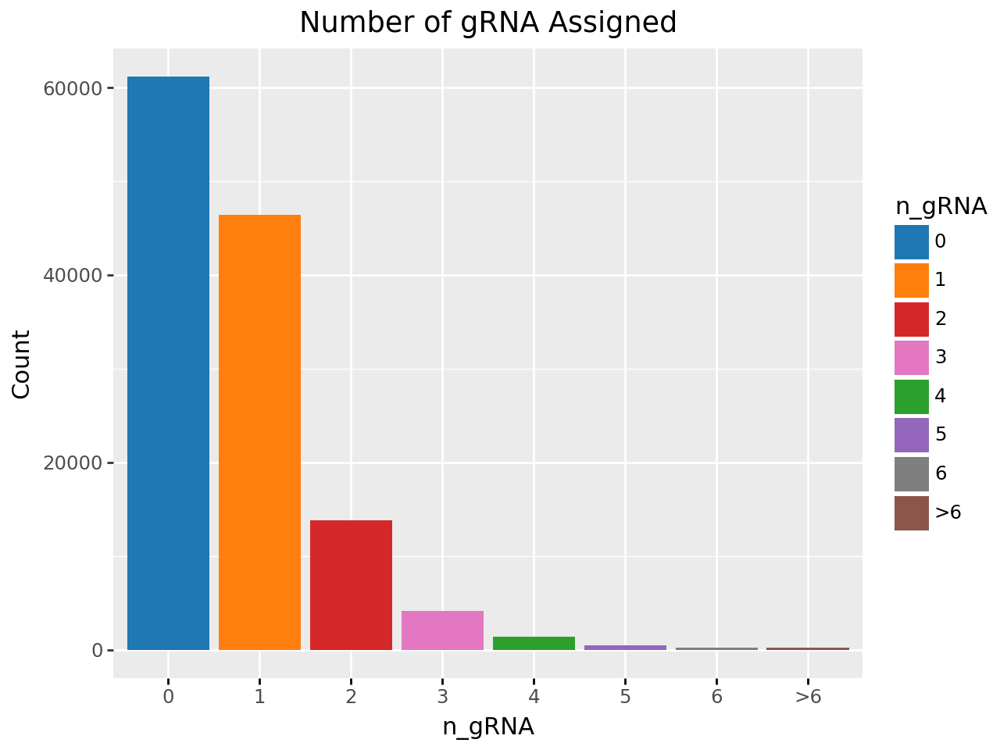

Cells without confident sgRNA calls: 47.84%
Estimated Multiplet Rate: 15.82%


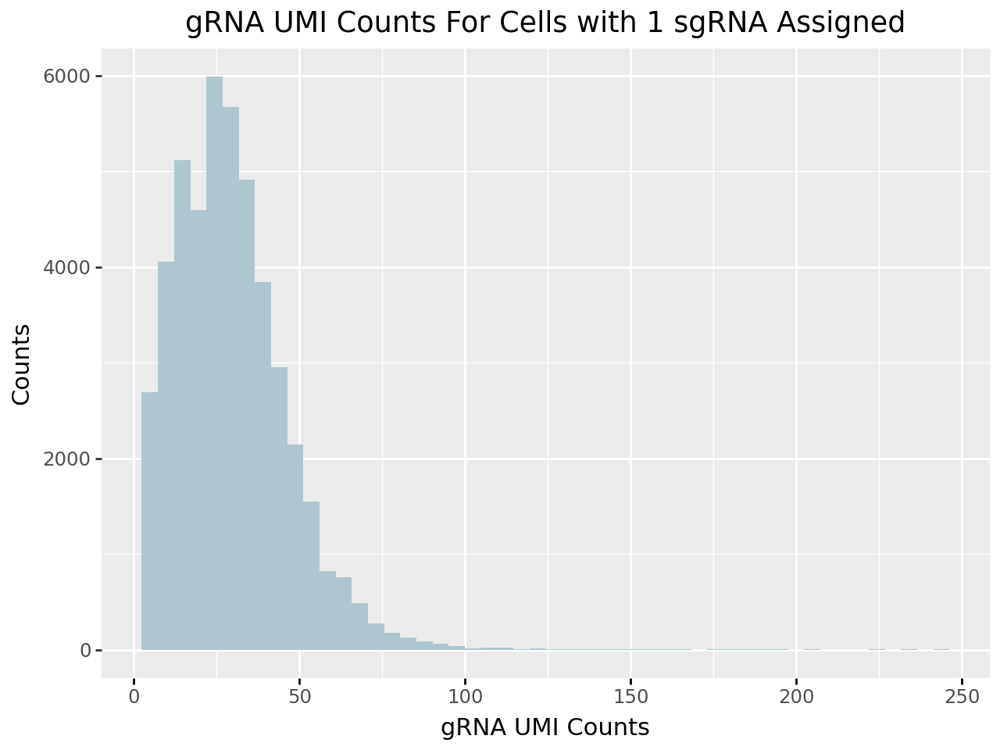

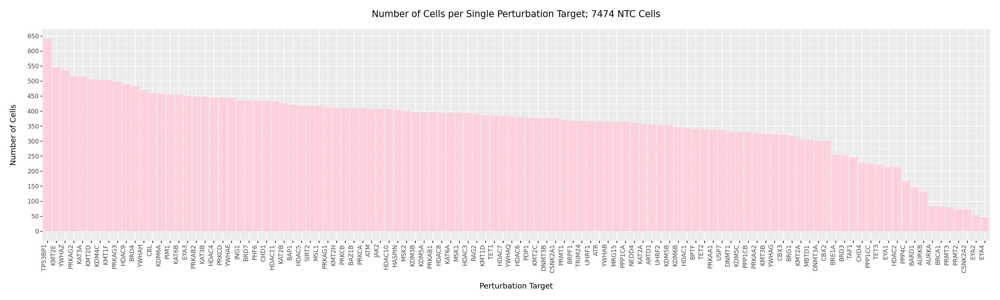

Number of perturbations with >= 50 cells with single guide assigned: 107/108 (99.07%)
Creating channel dictionary...
Assigning metadata...


/tmp/ipykernel_2119283/1744158997.py:33: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


  - ENSG00000293552
Saving pre-QC data to /tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers_Pre_QC.h5ad...
Performing general QC...
normalizing counts per cell
    finished (0:00:02)


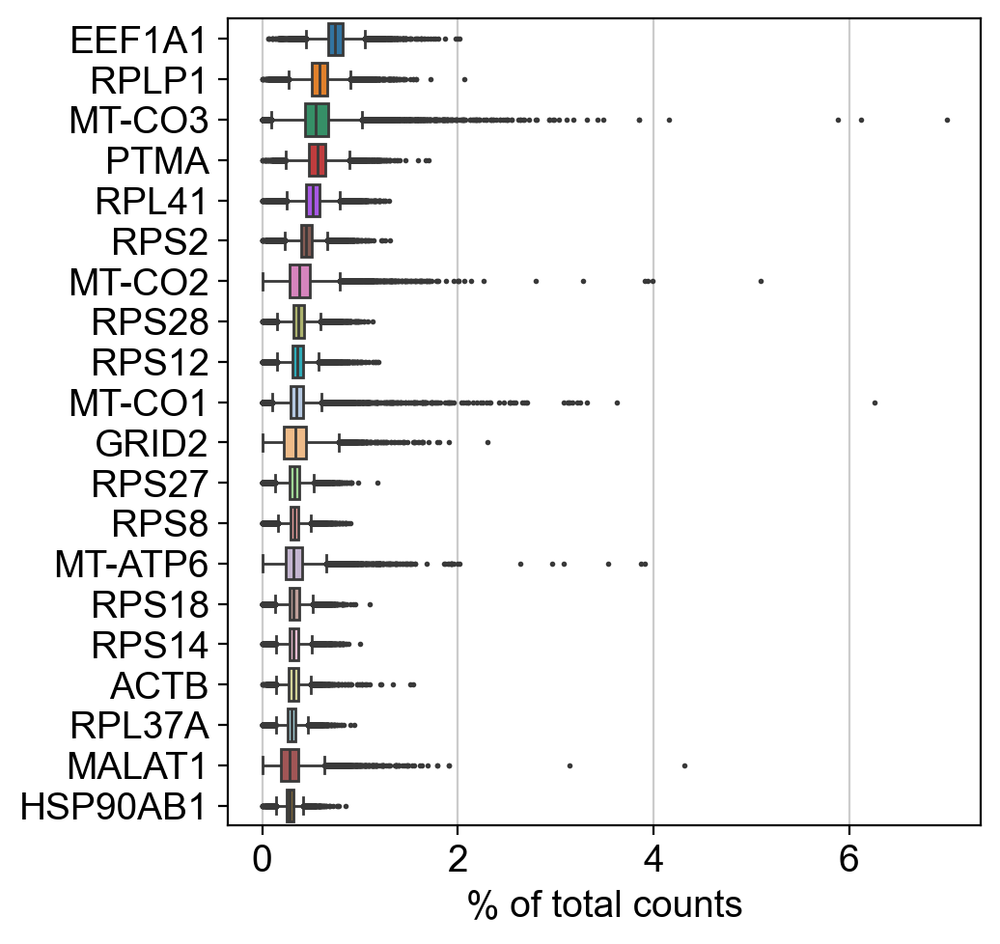

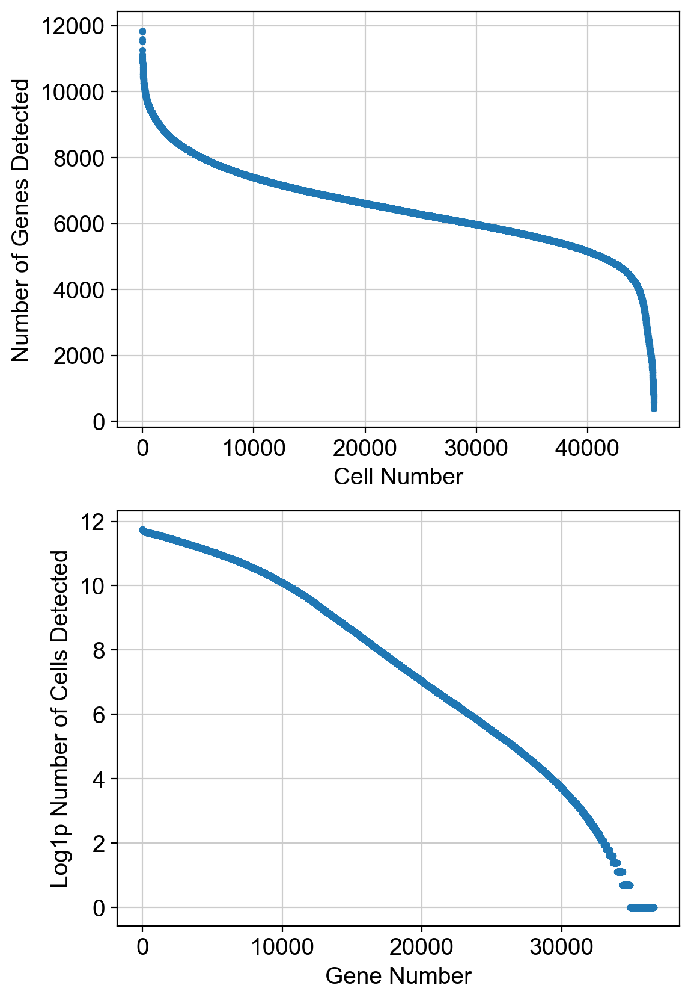

Removing 1706 genes not detected in any cells.
Performing dead cell QC...


/tmp/ipykernel_2119283/1744158997.py:33: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.


outlier
False    44039
True      1907
Name: count, dtype: int64

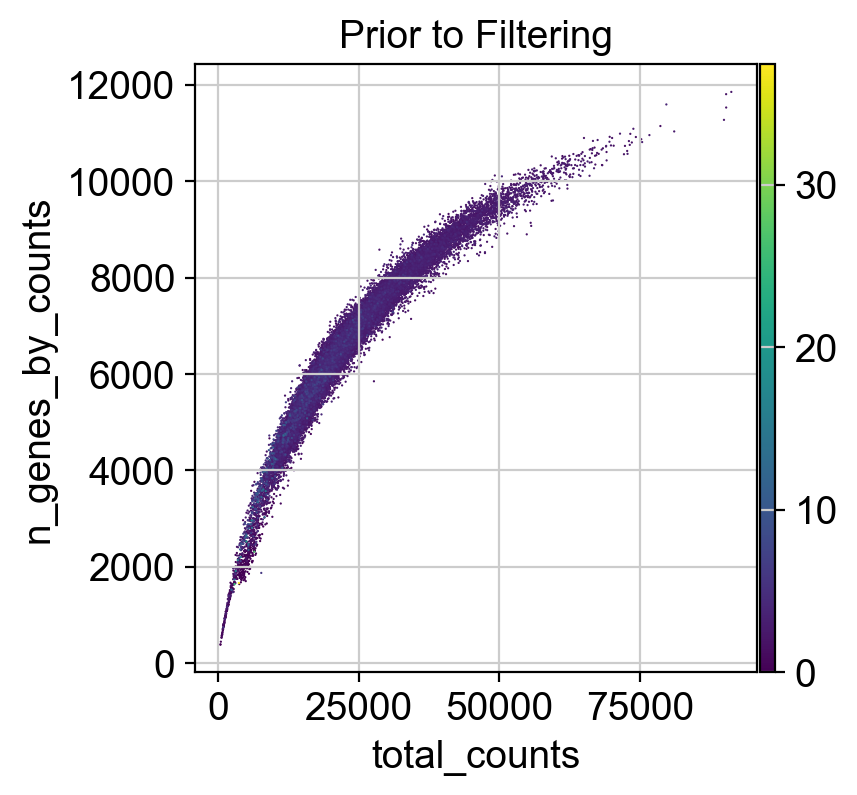

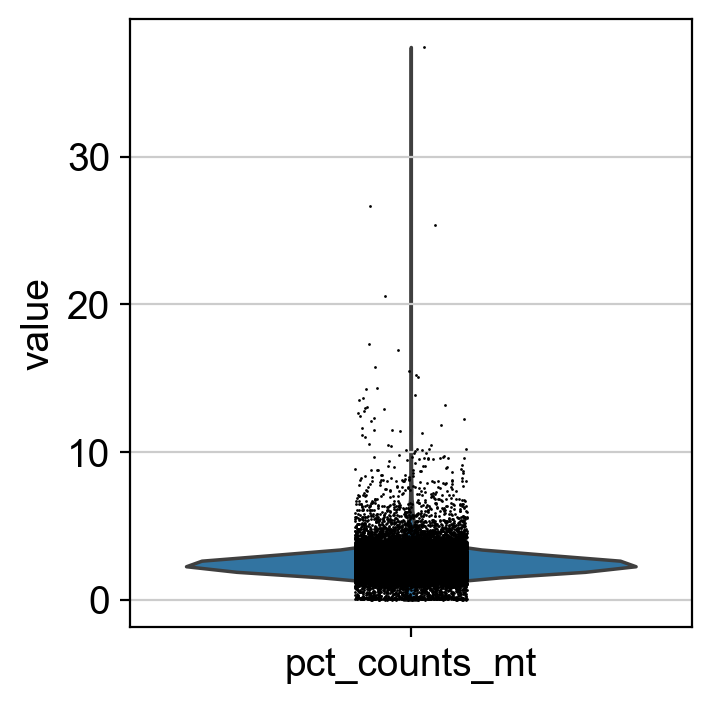

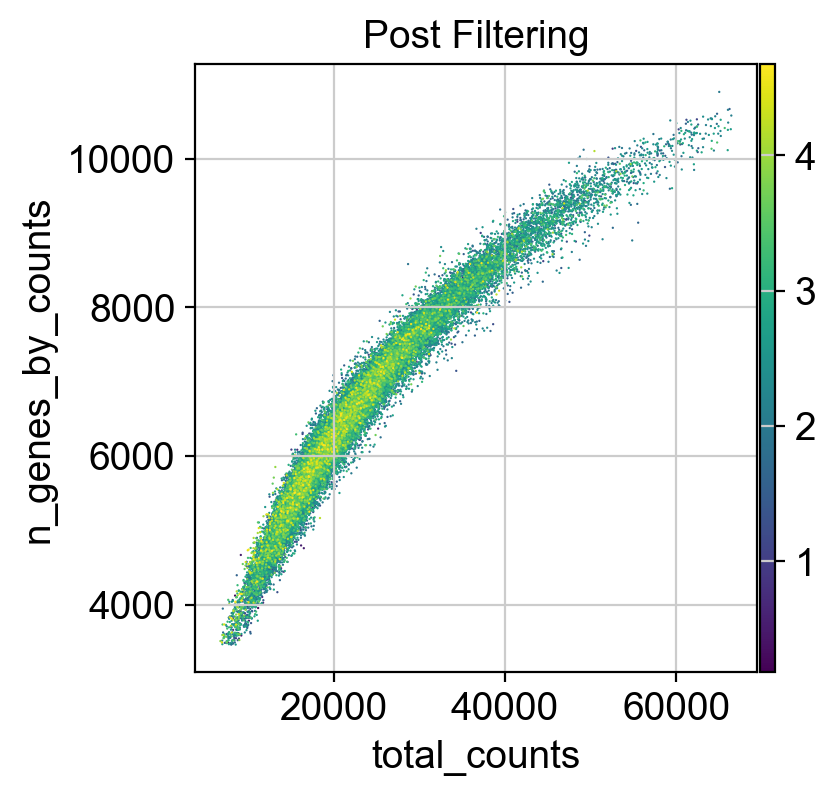

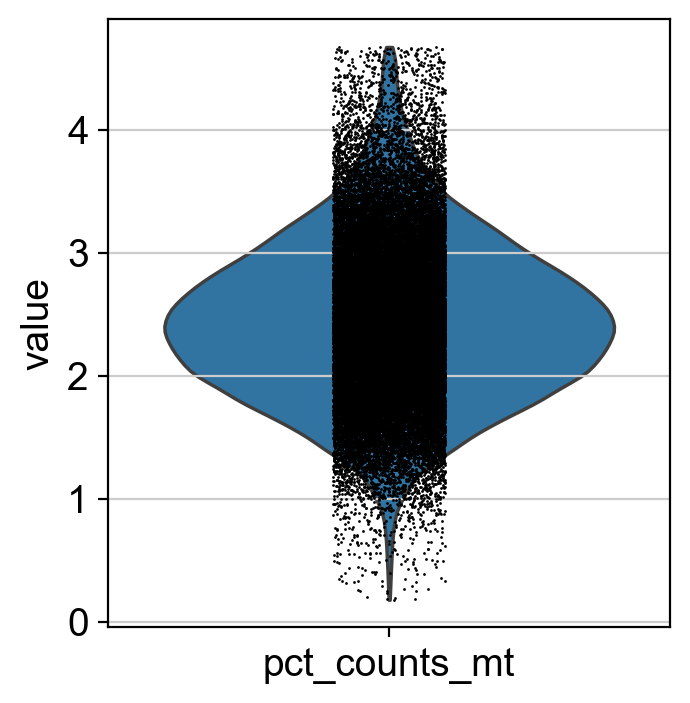

Performing doublet detection sanity check...


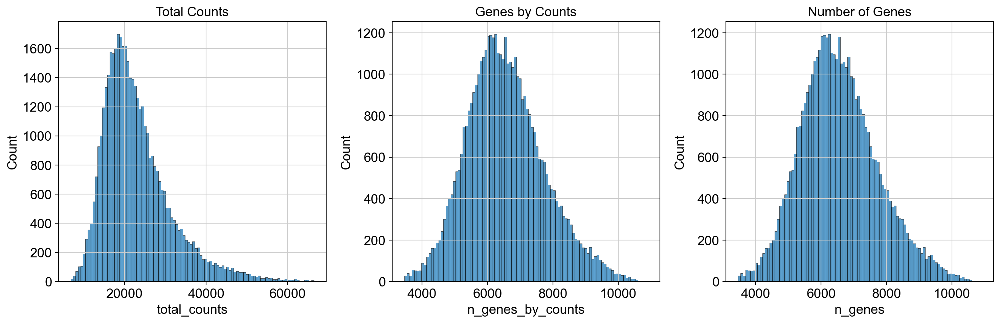

Saving final QC file to /tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers_QC_Filtered.h5ad...


In [5]:
mtx_dir = "/tscc/projects/ps-malilab-CM4AI/KOLF_Chromatin_Modifiers/cellranger_files/Aggregate/KOLF_Chromatin_Modifiers_Aggregate_10x_Analysis/outs/count/filtered_feature_bc_matrix"
save_directory = "/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers.h5mu"
protospacer_calls_file = "/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/10x_data_analysis_outputs/aggregate_analysis/protospacer_calls_per_cell.csv"
aggregation_csv = "/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/10x_data_analysis_outputs/aggregate_analysis/aggregation_csv.csv"
cell_type = "KRAB-ZIM3-dCas9 KOLF2.1J hiPSC"
perturbation_type = "CRISPRi"
pre_qc_save_path = "/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers_Pre_QC.h5ad"
final_save_path = "/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers_QC_Filtered.h5ad"
gene_id_filepath = "/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/10x_data_analysis_outputs/aggregate_analysis/gene_ids.txt"
obs_key = "gene_target_ensembl_id"
var_key = "gene_ids"
ntc_label = "NTC"
ntc_sgRNA_prefix = "NTC"
remove_batch_duplicates = False

input_dict = {
    "mtx_dir": mtx_dir,
    "save_directory": save_directory,
    "protospacer_calls_file": protospacer_calls_file,
    "aggregation_csv": aggregation_csv,
    "cell_type": cell_type,
    "perturbation_type": perturbation_type,
    "pre_qc_save_path": pre_qc_save_path,
    "final_save_path": final_save_path,
    "gene_id_filepath": gene_id_filepath,
    "obs_key": obs_key,
    "var_key": var_key,
    "ntc_label": ntc_label,
    "ntc_sgRNA_prefix": ntc_sgRNA_prefix,
    "remove_batch_duplicates": remove_batch_duplicates
}

adata = psp.qc.default_qc(input_dict)

### Scrubbing NTC Cells

Initial number of NTC Cells: 7161
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    342 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    255 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:02)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance

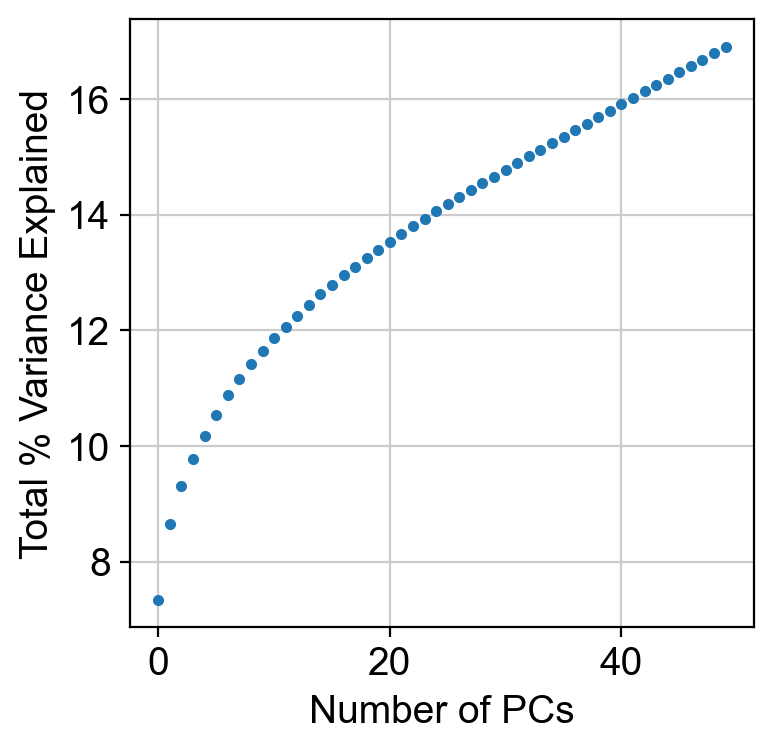

computing neighbors
    computing neighbors
    computed neighbors (0:00:00)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP


  0%|          | 0/500 [00:00<?, ?it/s]

	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


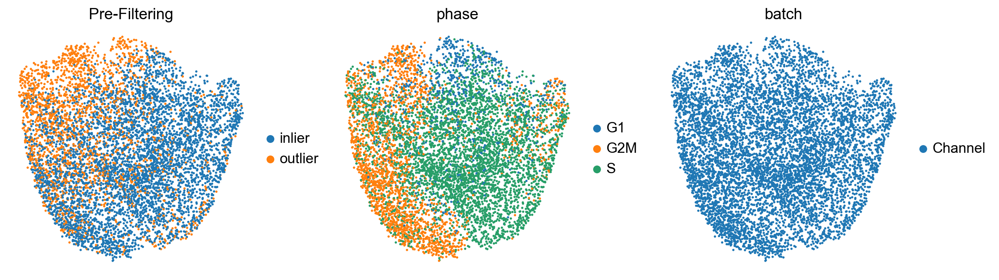

computing density on 'umap'
--> added
    'umap_density', densities (adata.obs)
    'umap_density_params', parameter (adata.uns)


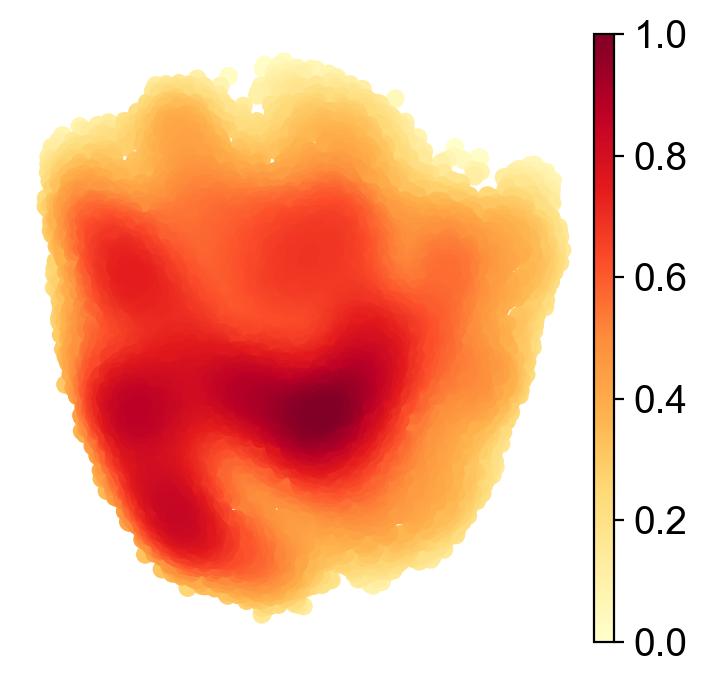

Removing 9 NTC guides due to having less than 25 cells
computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    computed neighbors (0:00:00)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP


  0%|          | 0/500 [00:00<?, ?it/s]

	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


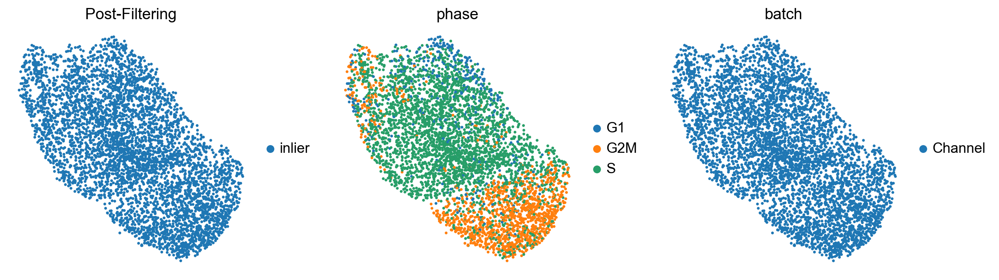

computing density on 'umap'
--> added
    'umap_density', densities (adata.obs)
    'umap_density_params', parameter (adata.uns)


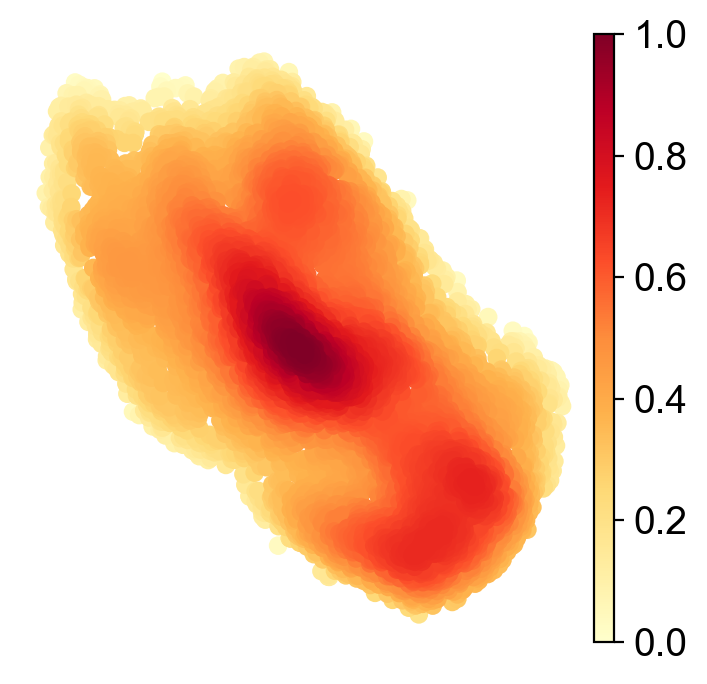

Number of NTC Cells after Isolation Forest filtering: 4839
Total number of cells after NTC cleaning: 41717
Number of NTC Cells per batch 
: batch
Channel    4839
Name: count, dtype: int64


In [6]:
adata_filepath = "/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers_QC_Filtered.h5ad"
adata = psp.utils.read_anndata(adata_filepath)
adata = psp.pp.clean_ntc_cells(adata, NTC_whitelist_path=None)
final_save_path = "/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_NTC_Filtered.h5ad"
adata.write(final_save_path)

### Filtering sgRNAs that cause sufficient target gene knockdown

In [48]:
adata = psp.utils.read_anndata("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_NTC_Filtered.h5ad")

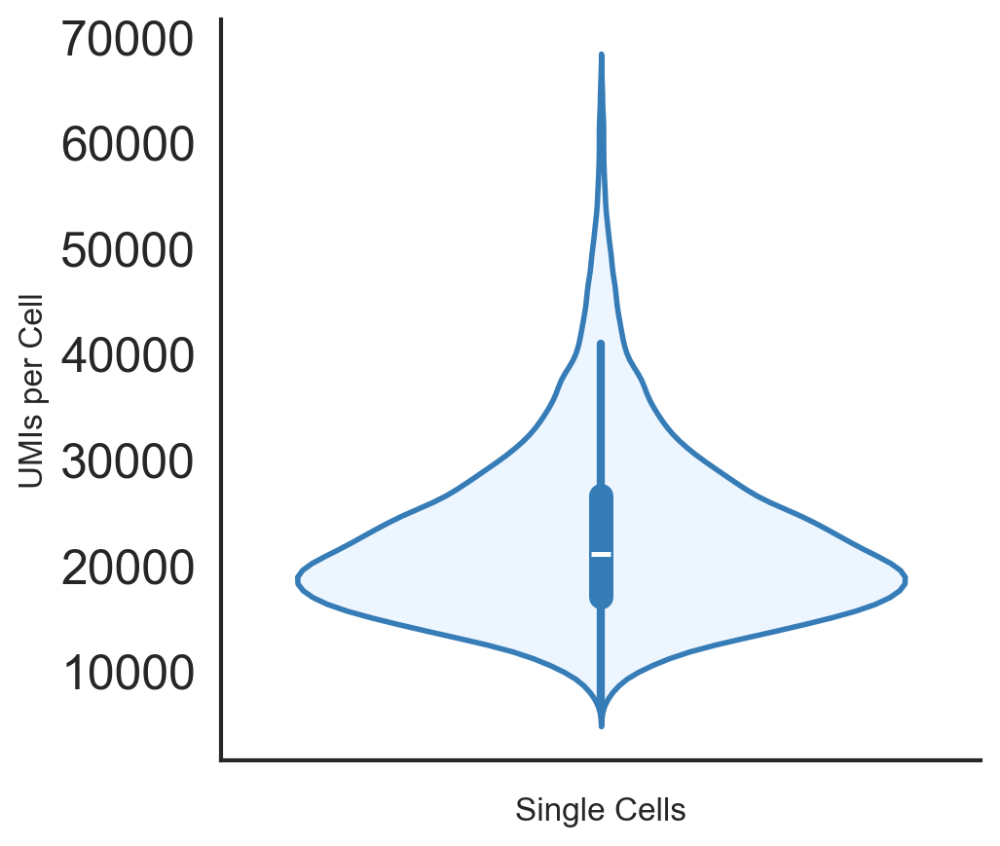

526/572 (91.96%) have > 25 cells


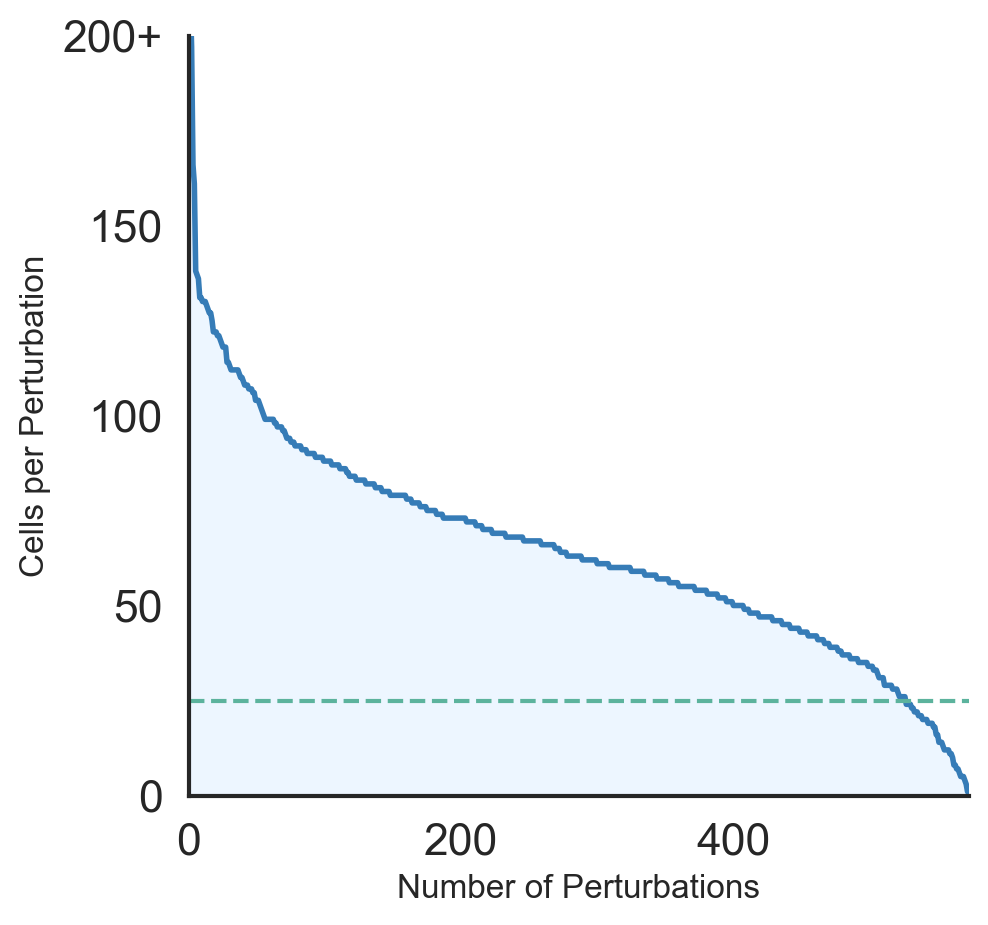

100/107 (93.46%) have > 100 cells


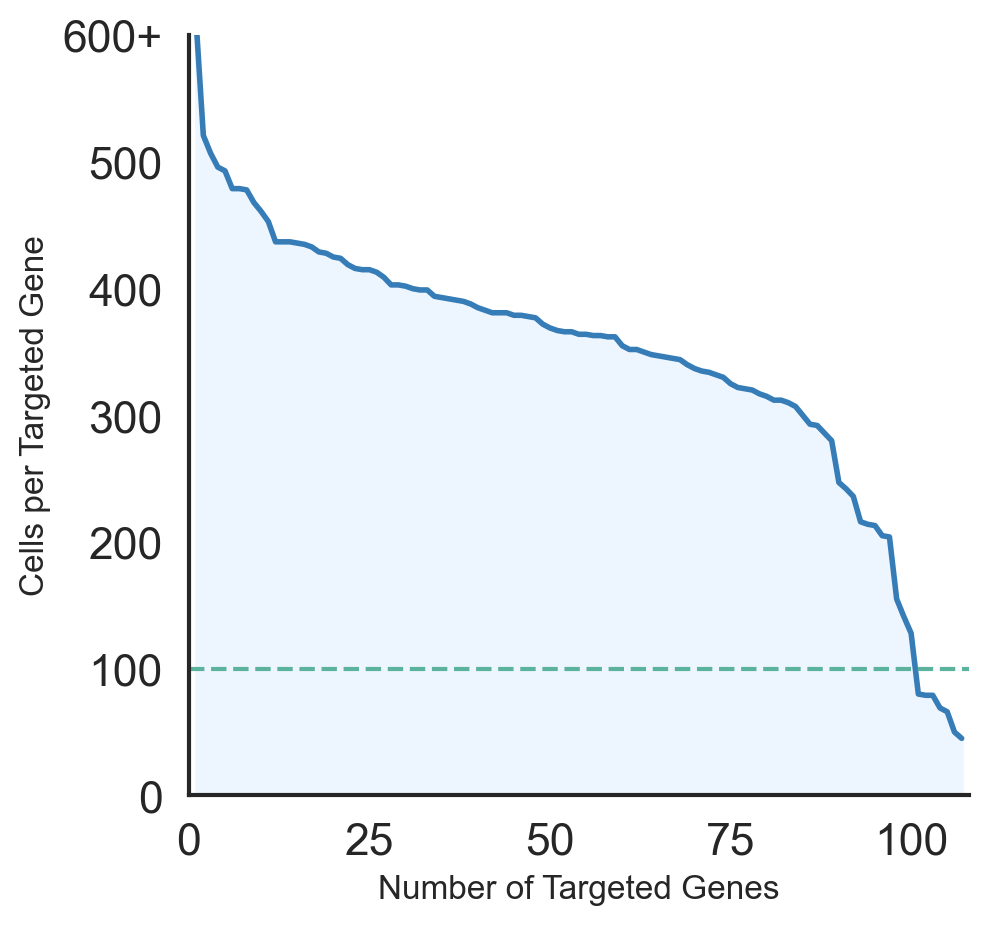

normalizing counts per cell
    finished (0:00:00)


In [49]:
fig = psp.pl.plot_umis_per_cell(adata)
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_umis_per_cell.png")
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_umis_per_cell.svg")
fig = psp.pl.plot_cells_per_perturbation(adata, perturbation_key = 'perturbation', xlabel='Number of Perturbations', ylabel='Cells per Perturbation', highlight_threshold=25, y_max=200, tick_spacing=50)
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_cells_per_perturbation.png")
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_cells_per_perturbation.svg")
fig = psp.pl.plot_cells_per_perturbation(adata, perturbation_key = 'gene_target', xlabel='Number of Targeted Genes', ylabel='Cells per Targeted Gene')
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_cells_per_gene_target.png")
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_cells_per_gene_target.svg")
adata = psp.pp.knockdown_qc(adata, batch_aware=False)
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_knockdown_qc.png")
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_knockdown_qc.svg")
adata.write("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Knockdown_Evaluated.h5ad")

Percentage of perturbations achieving 30.0% repression: 65.03% (372/572)
Percentage of perturbations achieving 30.0% repression: 68.22% (73/107)


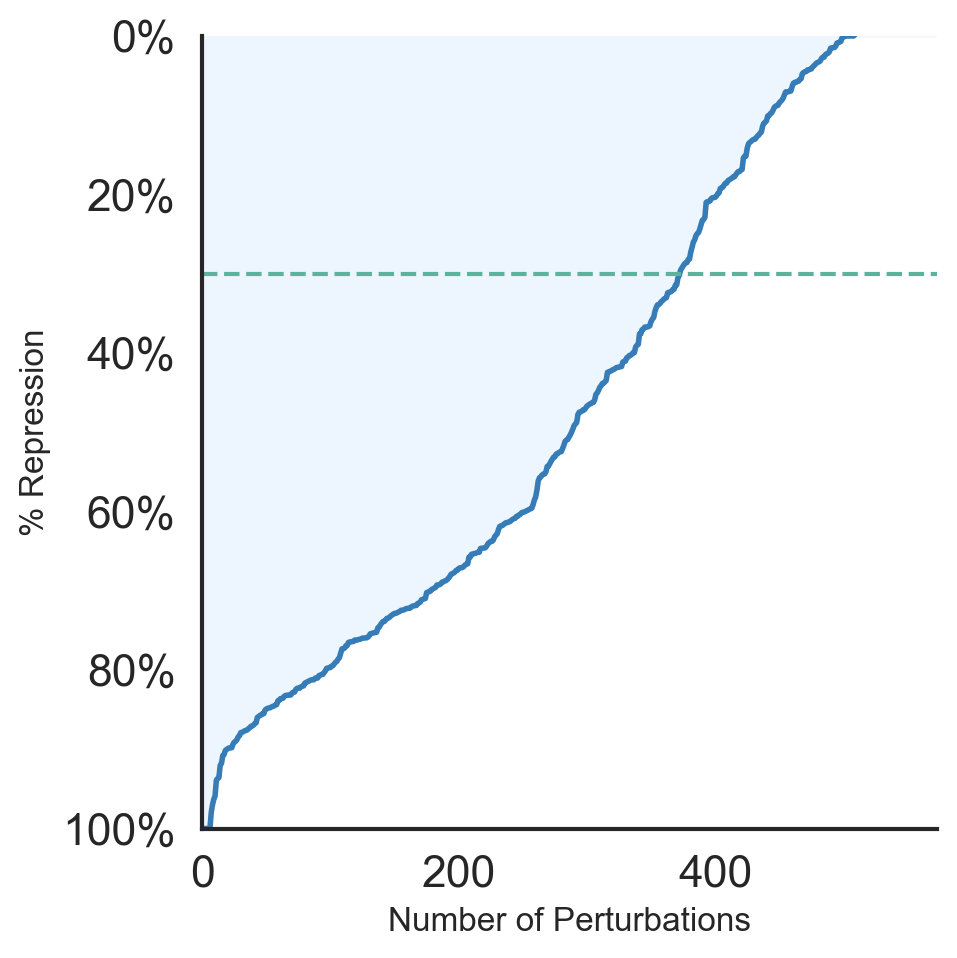

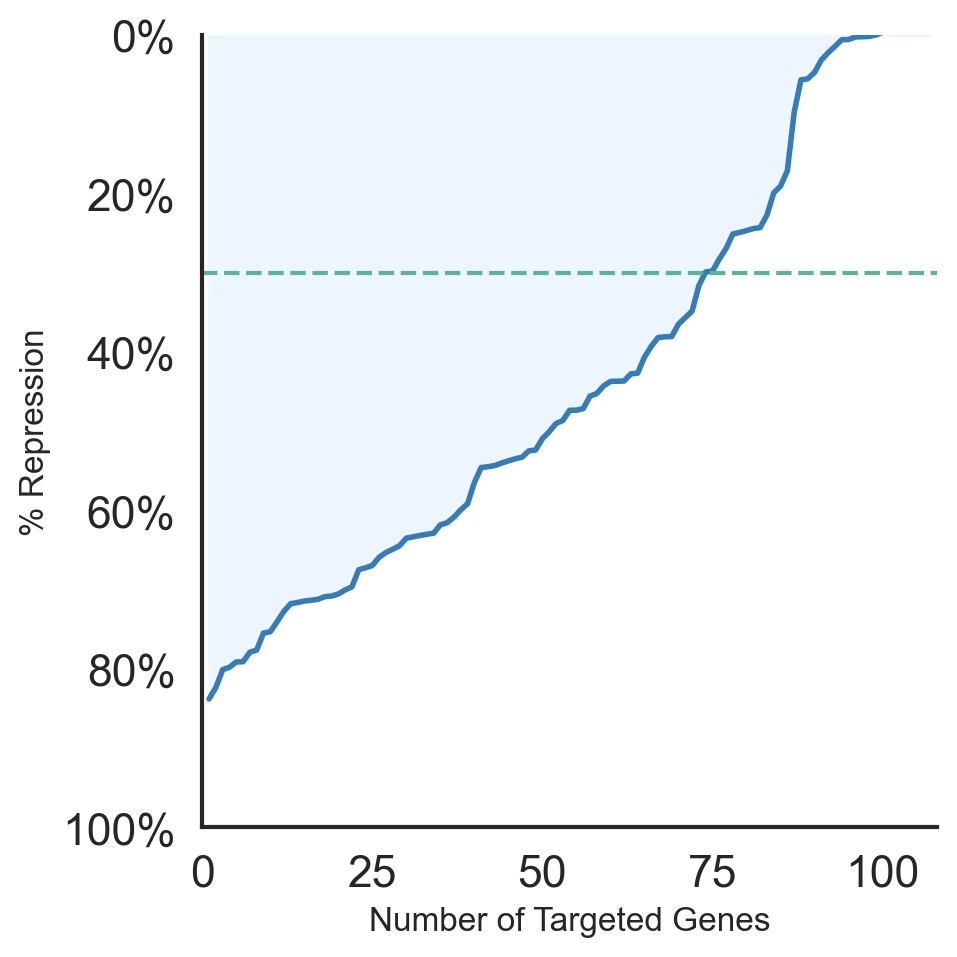

In [50]:
fig2 = psp.pl.plot_percentage_perturbations_by_repression(adata, perturbation_col='perturbation', xlabel='Number of Perturbations')
fig2.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_sgRNA_knockdown.png")
fig2.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_sgRNA_knockdown.svg")

fig2 = psp.pl.plot_percentage_perturbations_by_repression(adata, perturbation_col='gene_target', xlabel='Number of Targeted Genes')
fig2.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_gene_knockdown.png")
fig2.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_gene_knockdown.svg")

Processing batch: Channel
Removing 200 guides due to low repression (less than 30.0%)
Removing 2360 cells due to no repression (Target knockdown < 0)
Removing 42 guides due to low cell count per guide (less than 25 cells per guide)


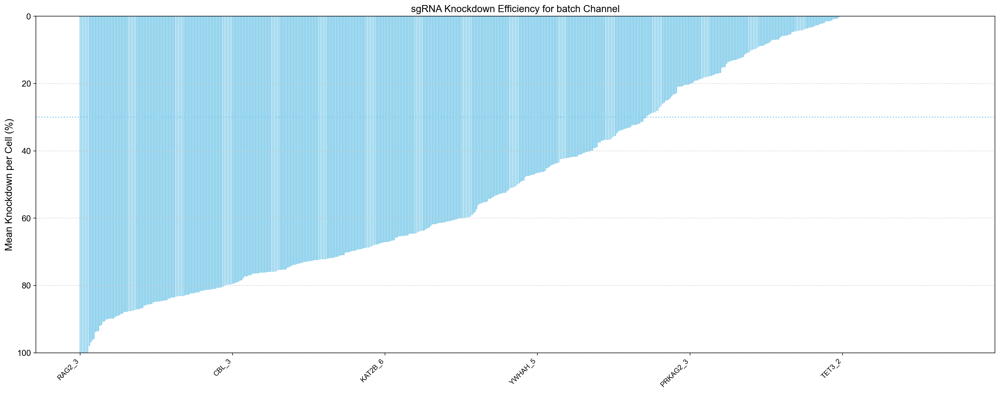

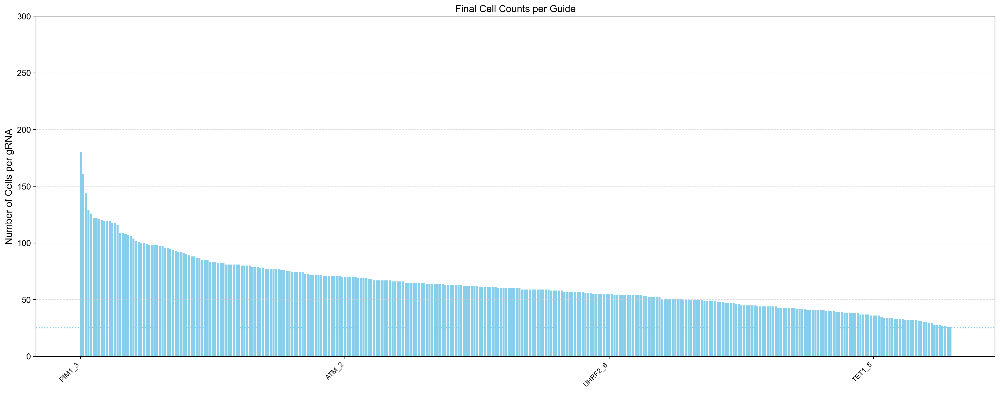

In [16]:
adata = psp.pp.evaluate_per_sgRNA_knockdown(adata, NTC_prefix="NTC")
adata.write("/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers_Knockdown_Evaluated.h5ad")

In [19]:
# Final statistics
print(f"Total number of cells: {adata.n_obs}")
print(f"Total number of NTC sgRNAs: {psp.utils.get_ntc_view(adata).obs.gRNA.nunique()}")
print(f"Total number of NTC cells: {psp.utils.get_ntc_view(adata).n_obs}")
print(f"Total number of perturbations: {psp.utils.get_perturbed_view(adata).obs.gRNA.nunique()}")
print(f"Total number of genes targeted: {psp.utils.get_perturbed_view(adata).obs.gene_target.nunique()}")
print(f"Median number of cells per perturbation: {psp.utils.get_perturbed_view(adata).obs.perturbation.value_counts().median()}")
print(f"Median number of cells per gene_target: {psp.utils.get_perturbed_view(adata).obs.gene_target.value_counts().median()}")

Total number of cells: 25695
Total number of NTC sgRNAs: 100
Total number of NTC cells: 4839
Total number of perturbations: 330
Total number of genes targeted: 85
Median number of cells per perturbation: 60.0
Median number of cells per gene_target: 267.0


### Computing the signficance of gRNA perturbation effects based on the energy distance test

/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pandas/core/arraylike.py:399: RuntimeWarning:

divide by zero encountered in log10

/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pandas/core/arraylike.py:399: RuntimeWarning:

invalid value encountered in log10



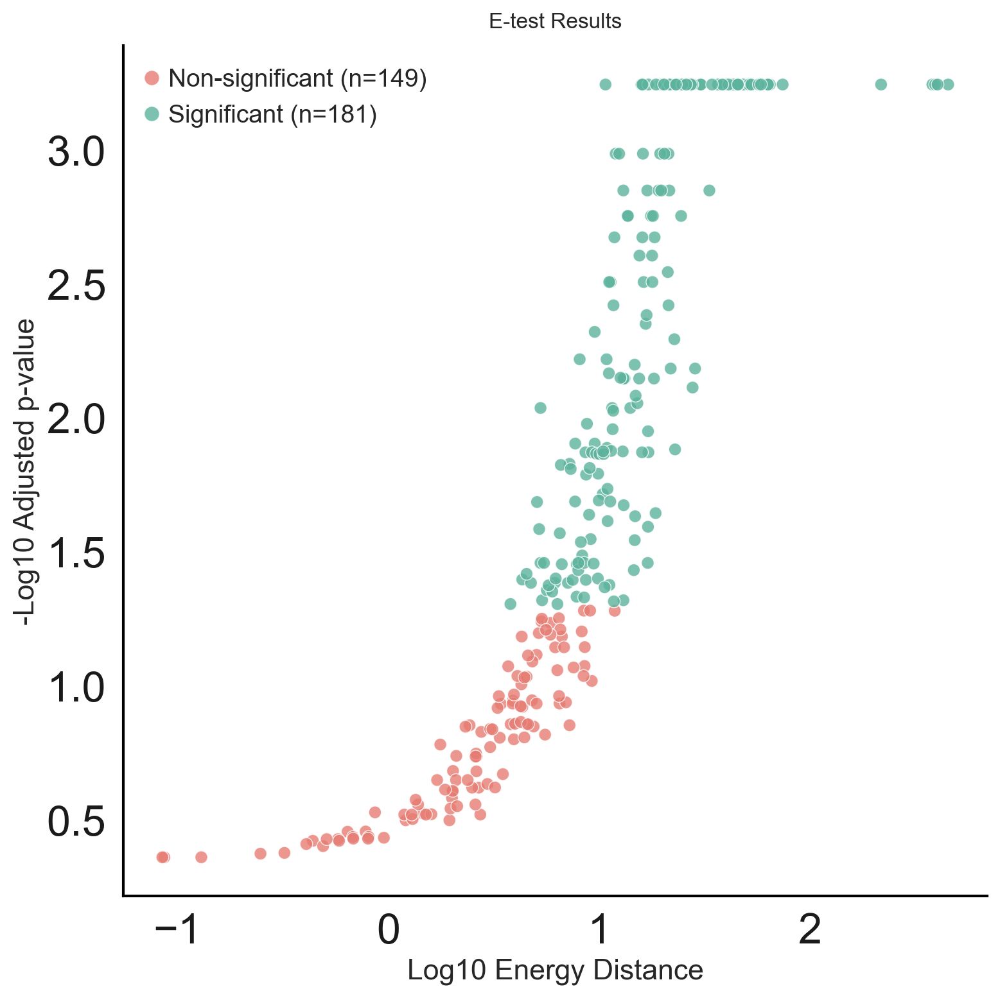

In [ ]:
adata = psp.utils.read_anndata("/tscc/projects/ps-malilab/ydoctor/CM4AI/KOLF_Chromatin_Modifiers/iPSC/adata_files/KOLF_Chromatin_Modifiers_Knockdown_Evaluated.h5ad")
estats = psp.da.compute_etest(adata)
adata.write("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_Computed.h5ad")
estats.to_csv("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Energy_Distance_Test.csv")
fig = psp.pl.plot_etest_results(estats, figsize=(8, 8), point_size=50)
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Energy_Distance_Test.svg")

In [54]:
estats = pd.read_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Energy_Distance_Test.csv', index_col=0)
estats.sort_values('edist').tail(10)[::-1]

,edist,pvalue,significant,pvalue_adj,significant_adj,neglog10_pvalue_adj,batch,cross_batch_pvalue_adj,cross_batch_significant,cross_batch_neglog10_pvalue_adj
DNMT1_1,448.467662,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
UHRF1_3,399.644500,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
DNMT1_5,389.189645,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
DNMT1_2,377.577644,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
UHRF1_2,215.852920,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
BPTF_3,73.779632,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
KAT3A_5,64.164877,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
KMT2D_4,62.899478,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
HDAC2_2,62.539331,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914
UHRF1_1,58.241278,0.0001,True,0.000571,True,3.2436,Channel,0.000569,True,3.244914


In [50]:
def filter_to_significant_perturbations(adata, sig_column = 'perturbation_cross_batch_significant', NTC_column = 'perturbed'):
    sig_cells = adata.obs[sig_column] == True
    NTCs = adata.obs[NTC_column] == "False"
    valid_cells = sig_cells | NTCs
    return adata[valid_cells].copy()

filtered_adata = filter_to_significant_perturbations(adata)

/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3579: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3579: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3579: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3579: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3579: ConstantI


Concordance between max repression and max energy distance:
  • 19/57 genes (33.3%) have the same sgRNA showing maximum repression and maximum energy distance
  • Average Pearson correlation between repression and energy distance: 0.067
  • Median Pearson correlation: 0.036
  • Found valid correlations for 26/57 genes


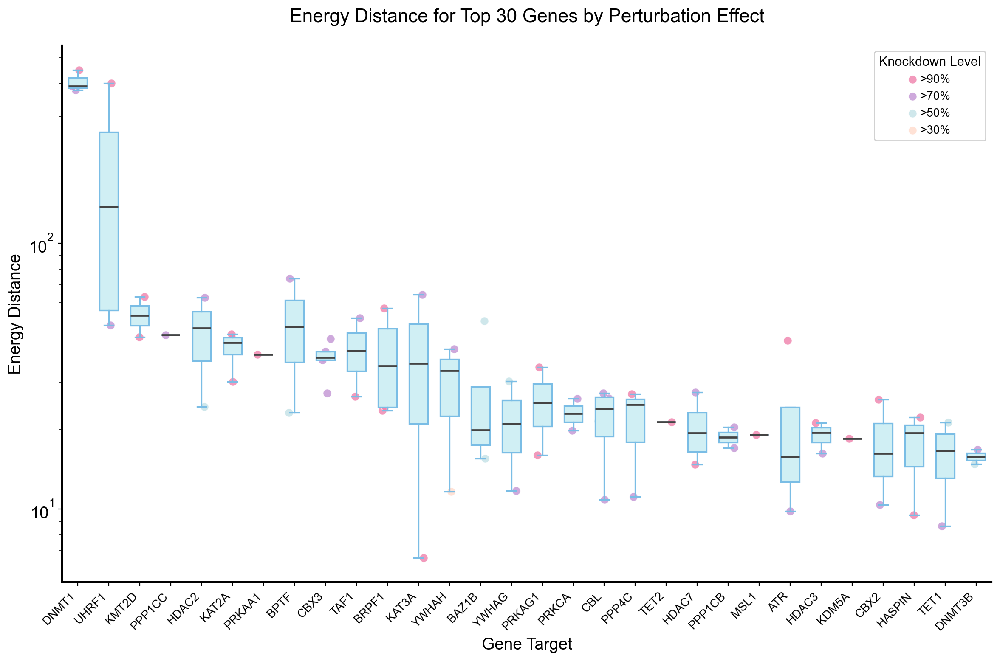

In [52]:
fig = psp.pl.plot_energy_distance_vs_knockdown(filtered_adata, log_scale=True, jitter_width=0.2)
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Energy_Distance_vs_Knockdown.svg")

### Investigating DEGs

Processing perturbations:   0%|          | 0/330 [00:00<?, ?it/s]

Total perturbations with >= 10 DEGs: 233 (70.61%)
Total perturbations with >= 25 DEGs: 156 (47.27%)
Total perturbations with >= 50 DEGs: 106 (32.12%)

Updating adata object with DEG counts
2025-04-24 16:16:57 - INFO - Completed differential expression analysis in 3791.03 seconds


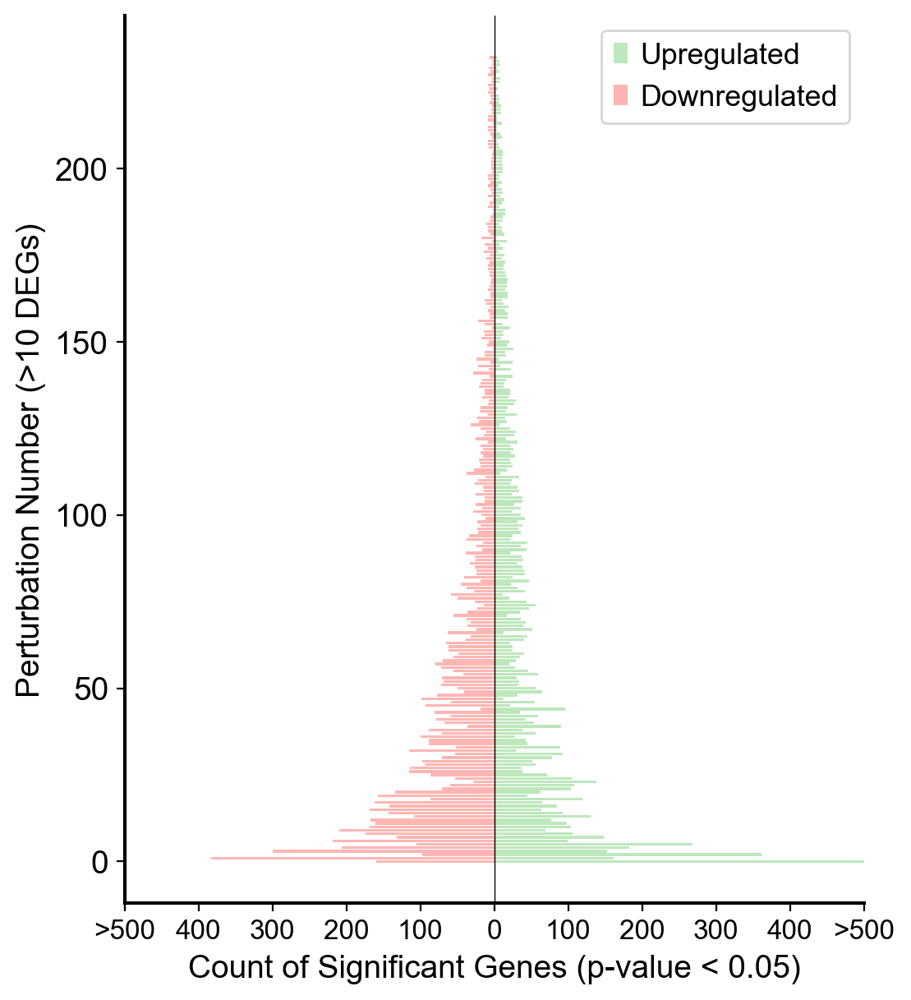

In [53]:
adata = psp.utils.read_anndata("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_Computed.h5ad")
res = psp.de.differential_expression(adata, adata_deg_test_column='perturbation', ntc_cells_delimiter='NTC', batch_key=None, n_replicates=3, sample_fraction=0.7, layer='counts', alpha=0.05, random_seed=42, save_path='/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_DEG_per_perturbation.xlsx', plot_degs=True, fig_save_path='/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_DEG_per_perturbation.svg',plot_genes_interval=50)
adata.write("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_Computed.h5ad")

In [61]:
adata = psp.utils.read_anndata("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_Computed.h5ad")

2025-04-24 16:24:39 - INFO - Using 4839 non-targeting control cells for benchmarking
2025-04-24 16:24:39 - INFO - Found 100 unique NTC sgRNAs


Benchmarking NTC sgRNAs:   0%|          | 0/100 [00:00<?, ?it/s]

2025-04-24 16:43:15 - INFO - Stored NTC FDR threshold (19) in adata.uns['ntc_fdr_threshold']
2025-04-24 16:43:15 - INFO - NTC Benchmark Statistics:
2025-04-24 16:43:15 - INFO -   • FDR 0.05 threshold: 19 DEGs
2025-04-24 16:43:15 - INFO -   • NTC comparisons analyzed: 100
2025-04-24 16:43:15 - INFO -   • Mean DEGs per comparison: 4.6
2025-04-24 16:43:15 - INFO -   • Median DEGs per comparison: 2.0
2025-04-24 16:43:15 - INFO -   • 95% of comparisons have < 19 DEGs
2025-04-24 16:43:15 - INFO - Using n_DEGs_perturbation for FDR significance
2025-04-24 16:43:15 - INFO - Added FDR significance column to adata.obs['exceeds_ntc_fdr']
2025-04-24 16:43:15 - INFO - Perturbations exceeding NTC FDR threshold: 180/330 (54.5%)


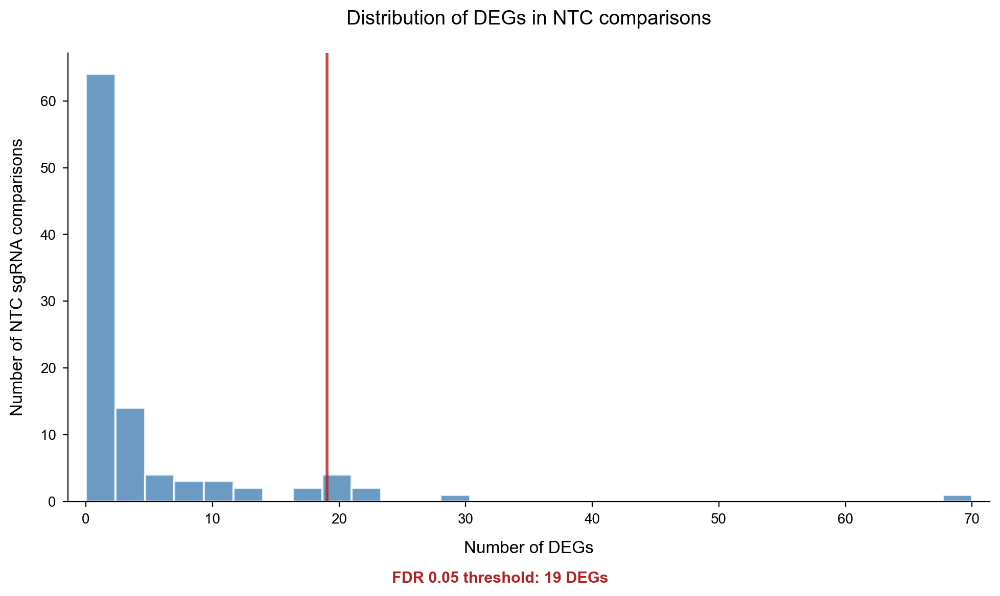

In [55]:
res = psp.de.benchmark_NTC_FDR(adata, ntc_cells_delimiter='NTC')

Plot statistics:
  • Total perturbations: 331
  • Perturbations with any significance: 64.4%
  • Perturbations significant in both metrics: 44.7%


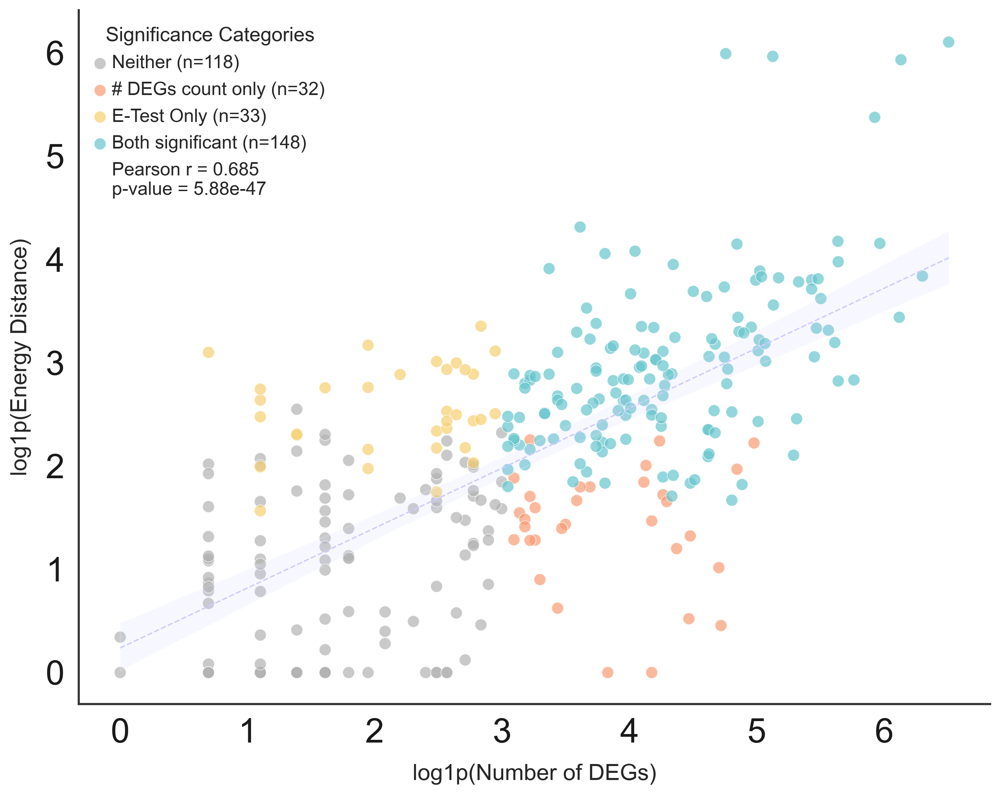

In [65]:
fig = psp.pl.plot_edist_vs_degs(adata)
fig.savefig("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Energy_Distance_vs_DEGs.svg")

In [57]:
def filter_to_significant_perturbations(adata, etest_sig_column = 'perturbation_cross_batch_significant', deg_sig_column = 'exceeds_ntc_fdr', NTC_column = 'perturbed'):
    etest_sig_cells = adata.obs[etest_sig_column] == True
    deg_sig_cells = adata.obs[deg_sig_column] == True
    sig_cells = etest_sig_cells & deg_sig_cells
    NTCs = adata.obs[NTC_column] == "False"
    valid_cells = sig_cells | NTCs
    return adata[valid_cells].copy()

filtered_adata = filter_to_significant_perturbations(adata)
filtered_adata.write('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_FDR_Filtered.h5ad')

In [78]:
DEGs.columns[:20]

Index(['DNMT1_DEGs', 'DNMT1_L2FC', 'DNMT1_Adj_P', 'KAT2A_DEGs', 'KAT2A_L2FC',
       'KAT2A_Adj_P', 'KMT2D_DEGs', 'KMT2D_L2FC', 'KMT2D_Adj_P', 'HDAC2_DEGs',
       'HDAC2_L2FC', 'HDAC2_Adj_P', 'CBX3_DEGs', 'CBX3_L2FC', 'CBX3_Adj_P',
       'UHRF1_DEGs', 'UHRF1_L2FC', 'UHRF1_Adj_P', 'SIRT2_DEGs', 'SIRT2_L2FC'],
      dtype='object')

### Filtering for perturbations with sufficient sgRNA coherence

Added 'coherent_target' column to adata.obs
- Cells with coherent targets: 6525/15153 cells (43.1%)
Perturbation coherence analysis:
- Total perturbations analyzed: 148
- Total genes with multiple perturbations: 66
- FDR threshold (at 70th percentile): 0.0405
- Perturbation pairs exceeding FDR: 87/125 (69.6%)
- Genes with coherent perturbations: 35/49 (71.4%)


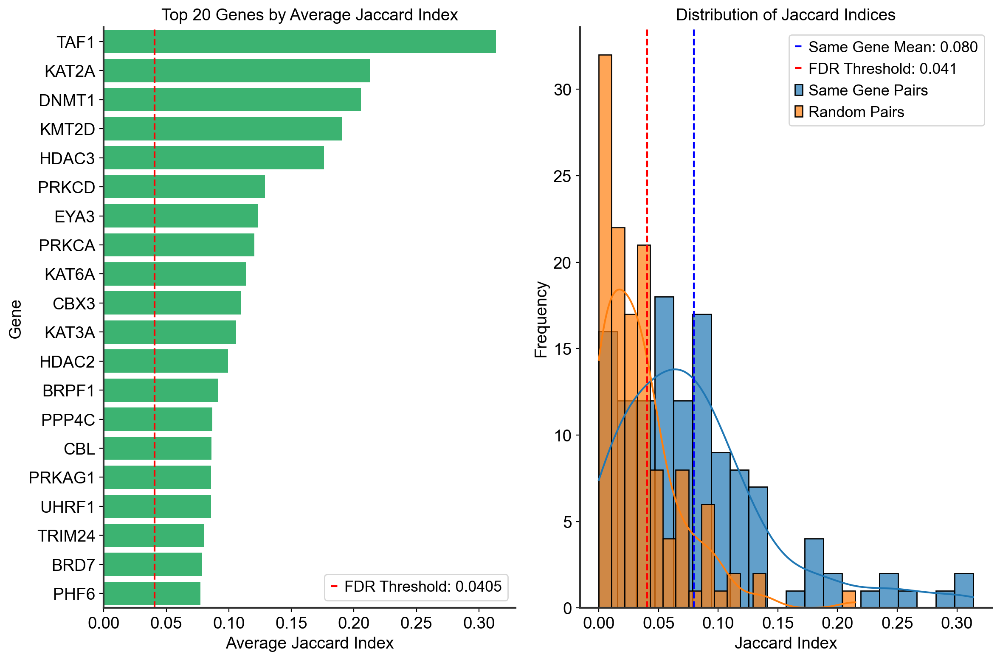

In [ ]:
import pandas as pd
adata = psp.utils.read_anndata('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_FDR_Filtered.h5ad')
DEGs = '/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_DEG_per_perturbation.xlsx'
res = psp.da.analyze_perturbation_coherence(adata, DEGs, fdr_percentile=70) #Because these are all chromatin modifiers, we can use a higher percentile for the FDR filter since its likely that they have some degree of overlap just because of this

In [59]:
def filter_to_coherent_perturbations(adata, coherent_target_column = 'coherent_target', NTC_column = 'perturbed'):
    coherent_cells = adata.obs[coherent_target_column] == True
    NTCs = adata.obs[NTC_column] == "False"
    valid_cells = coherent_cells | NTCs
    return adata[valid_cells].copy()

filtered_adata = filter_to_coherent_perturbations(adata)
filtered_adata.write('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_FDR_Filtered_Coherent.h5ad')

### Filtering at the Gene Level

Processing perturbations:   0%|          | 0/66 [00:00<?, ?it/s]

/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pydeseq2/dds.py:727: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pydeseq2/dds.py:727: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pydeseq2/dds.py:727: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pydeseq2/dds.py:727: UserWarning: The dispersion trend curve fitting did not converge. Switching to a mean-based dispersion trend.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pydeseq2/dds.py:727: UserWarning: The dispersion trend c

Total perturbations with >= 10 DEGs: 63 (95.45%)
Total perturbations with >= 25 DEGs: 58 (87.88%)
Total perturbations with >= 50 DEGs: 52 (78.79%)

Updating adata object with DEG counts
2025-07-11 09:55:31 - INFO - Completed differential expression analysis in 637.41 seconds


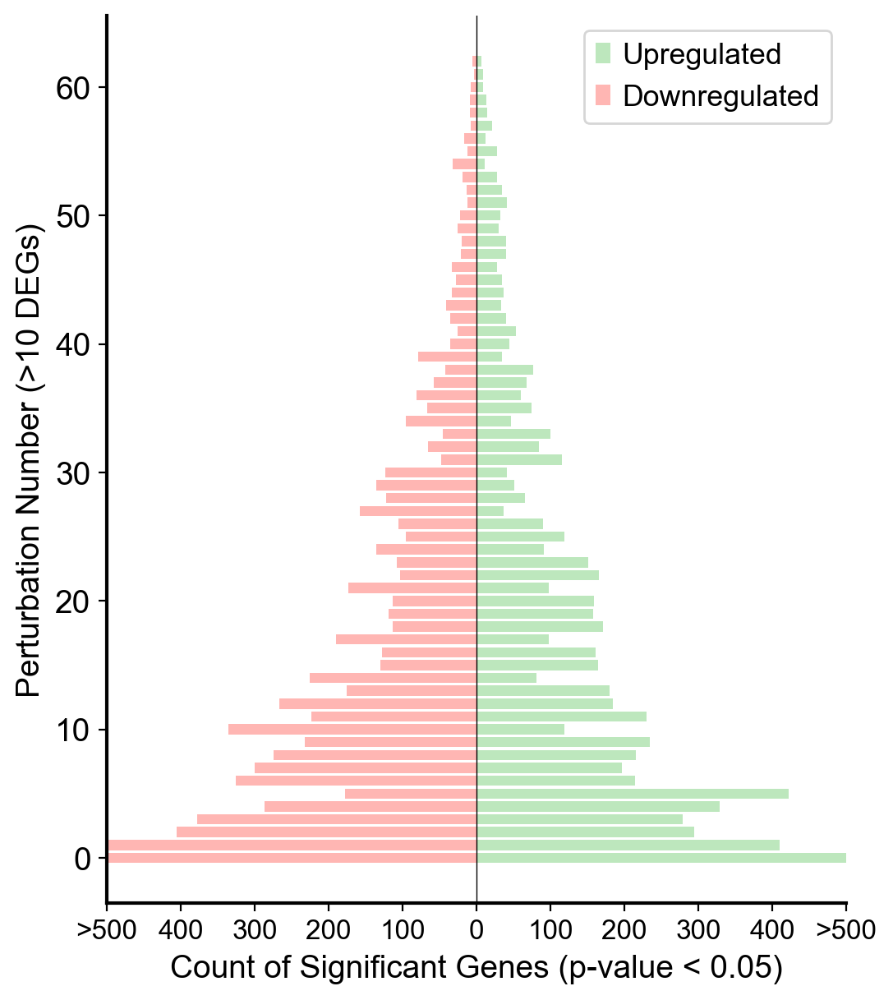

In [7]:
### Computing DEGs at the gene level
adata = psp.utils.read_anndata('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_FDR_Filtered.h5ad')
res = psp.de.differential_expression(adata, adata_deg_test_column='gene_target', ntc_cells_delimiter='NTC', batch_key=None, n_replicates=3, sample_fraction=0.7, layer='counts', alpha=0.05, random_seed=42, save_path='/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_DEGs_per_gene.csv', plot_degs=True, fig_save_path='/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_DEGs_per_gene.svg', plot_genes_interval=10)

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
computing PCA
    with n_comps=50


/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.


    finished (0:00:01)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PCs', the loadings (adata.varm)
    'pca_variance', the variance / eigenvalues (adata.uns['pca'])
    'pca_variance_ratio', the variance ratio (adata.uns['pca'])


  0%|          | 0/10000 [00:00<?, ?it/s]

/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
/tscc/nfs/home/ydoctor/miniconda3/envs/perturb_seq_env/lib/python3.11/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


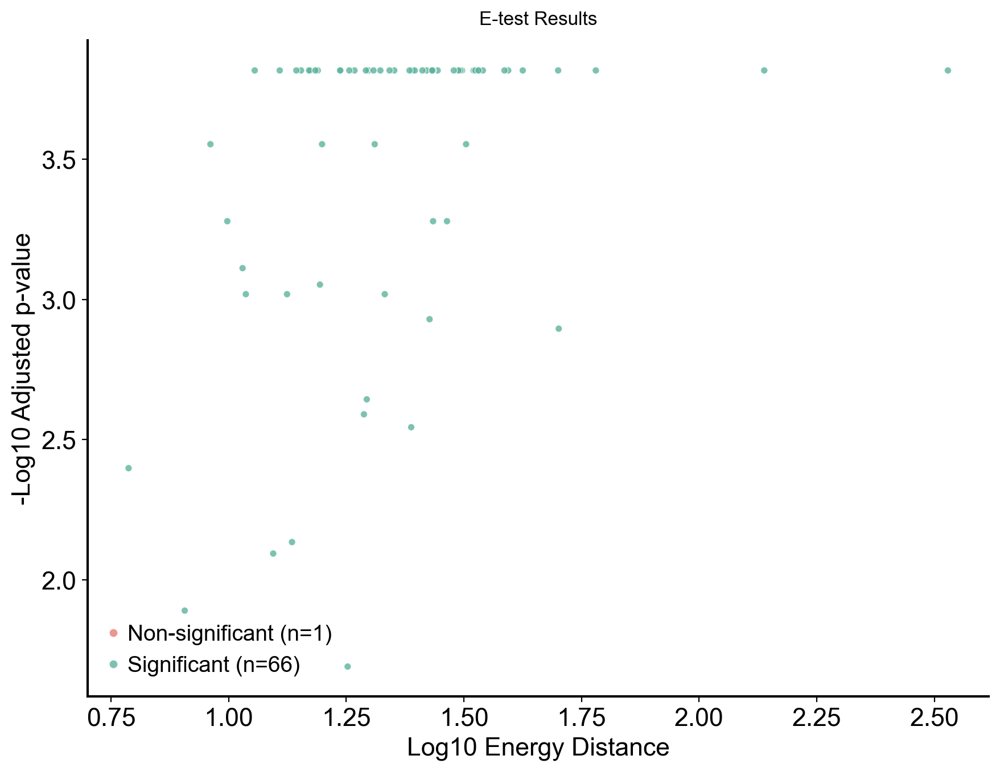

In [10]:
import numpy as np
import pandas as pd
import scperturb as scp
import scanpy as sc
from tqdm import tqdm
from joblib import Parallel, delayed
from tqdm.auto import tqdm
from statsmodels.stats.multitest import multipletests
from sklearn.metrics import pairwise_distances
def etest_deterministic(adata, seed=42, obs_key='perturbation', control='NTC', 
                         obsm_key='X_pca', dist='sqeuclidean', n_jobs=-1, 
                         verbose=True, runs=10000, correction_method='fdr_bh', alpha=0.05):
    """
    A deterministic version of energy test that ensures the same set of permutations
    is used each time the function is called with the same seed.
    
    Parameters:
        adata: AnnData object
        seed: Random seed for reproducibility
        obs_key: Key in adata.obs for perturbation labels
        control: Label for control cells
        obsm_key: Key in adata.obsm for coordinates
        dist: Distance metric to use
        n_jobs: Number of jobs for parallelization
        verbose: Whether to show progress
        runs: Number of permutations
        correction_method: Method for multiple testing correction
        alpha: Significance threshold
        
    Returns:
        DataFrame with energy test results
    """
    groups = pd.unique(adata.obs[obs_key])
    control = [control] if isinstance(control, str) else control
    
    # Precompute pairwise distances
    pwds = {}
    for group in groups:
        x = adata[adata.obs[obs_key].isin([group] + control)].obsm[obsm_key].copy()
        pwd = pairwise_distances(x, x, metric=dist)
        pwds[group] = pwd
    
    # Set up deterministic permutation seeds
    master_rng = np.random.RandomState(seed)
    
    # Pre-generate all permutation seeds - this is the key to ensuring
    # the same set of permutations is used each time
    permutation_seeds = [master_rng.randint(0, 2**32) for _ in range(runs)]
    
    # Function to run a permutation with a specific seed
    def one_permutation(perm_seed):
        # Create a new RNG with this specific seed
        perm_rng = np.random.RandomState(perm_seed)
        
        df = pd.DataFrame(index=groups, columns=['edist'], dtype=float)
        M = np.sum(adata.obs[obs_key].isin(control))  # number of cells in control group
        
        for group in groups:
            if group in control:
                # Nothing to test here
                df.loc[group] = 0
                continue
                
            N = np.sum(adata.obs[obs_key]==group)
            
            # Get labels and shuffle them with this permutation's RNG
            labels = adata.obs[obs_key].values[adata.obs[obs_key].isin([group] + control)]
            shuffled_labels = perm_rng.permutation(labels)
            
            # Calculate energy distance using precomputed pairwise distances
            sc_pwd = pwds[group]
            idx = shuffled_labels==group
            
            # Calculate energy distance components
            factor = N / (N-1)  # sample_correct=True
            factor_c = M / (M-1)
            delta = np.sum(sc_pwd[idx, :][:, ~idx]) / (N * M)
            sigma = np.sum(sc_pwd[idx, :][:, idx]) / (N * N) * factor
            sigma_c = np.sum(sc_pwd[~idx, :][:, ~idx]) / (M * M) * factor_c
            
            edistance = 2 * delta - sigma - sigma_c
            df.loc[group] = edistance
            
        return df
    
    # Run the permutations in parallel, each with its pre-determined seed
    progress_func = tqdm if verbose else lambda x: x
    permutation_results = Parallel(n_jobs=n_jobs)(
        delayed(one_permutation)(seed) for seed in progress_func(permutation_seeds)
    )
    
    # Calculate the original (non-permuted) energy distances
    original_df = pd.DataFrame(index=groups, columns=['edist'], dtype=float)
    M = np.sum(adata.obs[obs_key].isin(control))
    
    for group in groups:
        if group in control:
            original_df.loc[group] = 0
            continue
            
        N = np.sum(adata.obs[obs_key]==group)
        
        # Get the original (non-shuffled) labels
        labels = adata.obs[obs_key].values[adata.obs[obs_key].isin([group] + control)]
        
        # Calculate energy distance
        sc_pwd = pwds[group]
        idx = labels==group
        
        factor = N / (N-1)
        factor_c = M / (M-1)
        delta = np.sum(sc_pwd[idx, :][:, ~idx]) / (N * M)
        sigma = np.sum(sc_pwd[idx, :][:, idx]) / (N * N) * factor
        sigma_c = np.sum(sc_pwd[~idx, :][:, ~idx]) / (M * M) * factor_c
        
        edistance = 2 * delta - sigma - sigma_c
        original_df.loc[group] = edistance
    
    # Count how many permutations had greater or equal energy distance
    # (indicates the permutation looks more extreme than the actual data)
    count_greater = np.zeros(len(groups), dtype=int)
    
    for i, group in enumerate(groups):
        for perm_result in permutation_results:
            if perm_result.loc[group, 'edist'] >= original_df.loc[group, 'edist']:
                count_greater[i] += 1
    
    # Calculate p-values
    pvalues = pd.Series(np.clip(count_greater, 1, np.inf) / runs, index=groups)
    
    # Apply multiple testing correction
    significant_adj, pvalue_adj, _, _ = multipletests(
        pvalues.values, alpha=alpha, method=correction_method
    )
    
    # Compile results into a DataFrame
    tab = pd.DataFrame({
        'edist': original_df['edist'],
        'pvalue': pvalues,
        'significant': pvalues < alpha,
        'pvalue_adj': pvalue_adj,
        'significant_adj': significant_adj
    }, index=groups)
    
    return tab

def compute_etest(adata, seed, num_ntc_cells=400, n_hvg=2000):
    np.random.seed(seed)
    # ad = scp.utils.equal_subsampling(adata, 'gene_target', n_sub)
    # Randomly subsample NTC cells to 3000
    control_label = 'NTC'
    control_mask = adata.obs['gene_target'] == control_label
    control_idx = np.where(control_mask)[0]
    if len(control_idx) > num_ntc_cells:
        sampled_control_idx = np.random.choice(control_idx, size=num_ntc_cells, replace=False)
    else:
        sampled_control_idx = control_idx
    non_control_idx = np.where(~control_mask)[0]
    subset_idx = np.concatenate([sampled_control_idx, non_control_idx])
    ad = adata[subset_idx].copy()
    sc.pp.highly_variable_genes(
        ad,
        n_top_genes=n_hvg,
        flavor='seurat_v3_paper',
        batch_key='batch',
        subset=True,
        layer='counts'
    )
    sc.pp.scale(ad)
    sc.pp.pca(ad, n_comps=50)
    edf = etest_deterministic(ad, seed=seed, obs_key='gene_target', control='NTC', obsm_key='X_pca', dist='sqeuclidean', n_jobs=-1, verbose=True, runs=10000, correction_method='fdr_bh', alpha=0.05)
    return edf

filtered_adata = psp.utils.read_anndata('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/anndata_objects/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_FDR_Filtered.h5ad')
filtered_adata.X = filtered_adata.layers['counts'].copy()
DEGs = pd.read_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_DEGs_per_gene.csv')
sc.pp.normalize_total(filtered_adata, target_sum=1e6)
sc.pp.log1p(filtered_adata)
adata_edist = filtered_adata.copy()
etest = compute_etest(adata_edist, seed=42)
etest['significant_adj'] = etest['significant_adj'].astype(str)
fig = psp.pl.plot_etest_results(etest,significance_column='significant_adj', pvalue_column='pvalue_adj')
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Energy_Test_DEGs_Per_Gene_Target.svg')

In [11]:
DEGs_per_perturbation = dict()
for col in DEGs.columns:
    if '_DEG' in col:
        perturbation = col.split('_')[0]
        DEGs_per_perturbation[perturbation] = DEGs[col].count()
DEGs_per_perturbation = pd.DataFrame(DEGs_per_perturbation.items(), columns=['gene_target', 'n_DEGs'])
DEGs_per_perturbation.index = DEGs_per_perturbation['gene_target']
DEGs_per_perturbation.drop(columns=['gene_target'], inplace=True)
perturbation_stats = DEGs_per_perturbation.merge(etest, left_index=True, right_index=True, how='left')
perturbation_stats.to_csv("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Stats.csv")
# filter for perturbations with more than 1 DEG and positive edist
perturbation_stats_filtered = perturbation_stats[
    (perturbation_stats['n_DEGs'] > 19) &
    (perturbation_stats['significant_adj'] == 'True')
]
perturbation_stats_filtered.to_csv("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Stats_Filtered.csv")
perts = perturbation_stats_filtered.index.tolist() + ['NTC']
adata_filtered = adata[adata.obs['gene_target'].isin(perts)].copy()
adata_filtered.write_h5ad("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/KOLF_Chromatin_Modifiers_Energy_Test_Gene_Level_DEG_Etest_Filtered.h5ad")

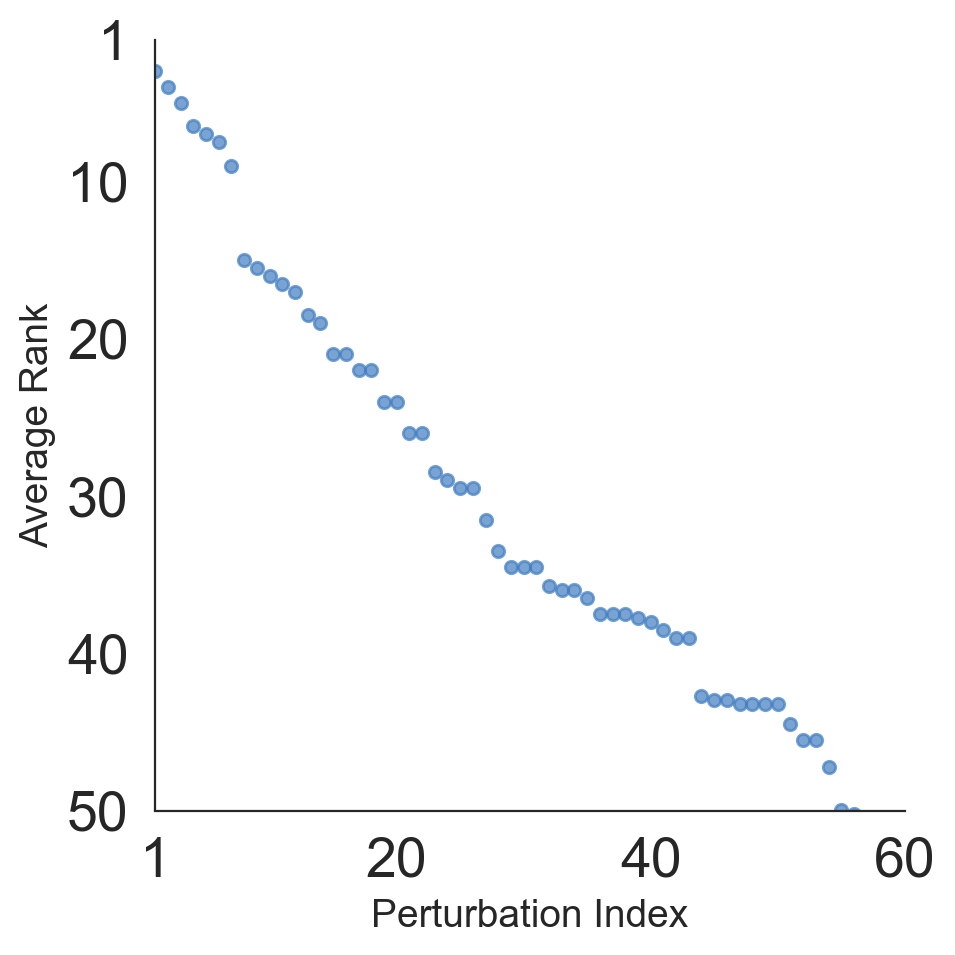

,gene_target,n_DEGs,edist,pvalue,significant,pvalue_adj,significant_adj,edist_rank,n_DEGs_rank,avg_rank
0,DNMT1,1677,337.972237,0.0001,True,0.000152,True,1.0,1.0,1.0
2,KMT2D,700,60.322143,0.0001,True,0.000152,True,3.0,3.0,3.0
5,UHRF1,600,137.568383,0.0001,True,0.000152,True,2.0,6.0,4.0
4,CBX3,616,50.165186,0.0001,True,0.000152,True,5.0,5.0,5.0
3,HDAC2,657,34.709116,0.0001,True,0.000152,True,9.0,4.0,6.5
1,KAT2A,1056,33.961785,0.0001,True,0.000152,True,12.0,2.0,7.0
8,HDAC7,490,42.193058,0.0001,True,0.000152,True,6.0,9.0,7.5
10,YWHAH,455,39.286181,0.0001,True,0.000152,True,7.0,11.0,9.0
19,BAZ1B,277,34.113431,0.0001,True,0.000152,True,10.0,20.0,15.0
7,CBX2,497,27.079092,0.0001,True,0.000152,True,23.0,8.0,15.5


In [36]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Read the data
data = pd.read_csv("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Stats_Filtered.csv")

# Create rankings for edist and n_DEGs
data['edist_rank'] = data['edist'].rank(ascending=False)  # Higher edist = better rank
data['n_DEGs_rank'] = data['n_DEGs'].rank(ascending=False)  # Higher n_DEGs = better rank

# Calculate average rank
data['avg_rank'] = (data['edist_rank'] + data['n_DEGs_rank']) / 2

# Sort by average rank (lowest to highest)
data_sorted = data.sort_values('avg_rank')

# Create the plot
fig, ax = plt.subplots(figsize=(5, 5))
ax.scatter(range(len(data_sorted)), data_sorted['avg_rank'], alpha=0.7, s=20, color='#417dc1')
ax.set_xlabel('Perturbation Index', fontsize=14)
ax.set_ylabel('Average Rank', fontsize=14)


# # Set x-axis ticks every 500 perturbations
ax.tick_params(axis='both', labelsize=20)
ax.set_xlim(1, 60)
ax.set_xticks([1, 20, 40, 60])
ax.set_ylim(1, 50)
ax.set_yticks([1, 10, 20, 30, 40, 50])
ax.invert_yaxis()  # Invert y-axis so lower ranks (better) are at top

# Only show x and y axis lines, not the full box
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)
plt.grid(False)

plt.tight_layout()
plt.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Strong_Perturbation_Ranking.svg')
plt.show()

# Display the data sorted by average rank, showing top 25
data_sorted.head(30)

In [3]:
import sys
import os
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

repo_root = "/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/"
if repo_root not in sys.path:
    sys.path.insert(0, repo_root)

import psp

# Reload the package
import sys
# Remove the main package if it's in sys.modules
if 'psp' in sys.modules:
    del sys.modules['psp']

# Remove any submodules of psp
for mod in list(sys.modules.keys()):
    if mod.startswith('psp.'):
        del sys.modules[mod]
import psp

import anndata as ad
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import scperturb as scp
from scipy.spatial.distance import squareform, pdist
from tqdm_joblib import tqdm_joblib
from scipy.stats import spearmanr
from joblib import Parallel, delayed
from joblib import parallel_backend
from tqdm.auto import tqdm
from scipy import sparse
import SEACells

Reading in data and applying feature selection using the same parameters as Replogle et al. They choose the top 10 DEGs per perturbation, but in this case we choose to do the top 5 up and top 5 down DEGs per perturbation as identified by DESeq2 with L2FC > 2 and top 10% of HVGs

In [4]:
adata = psp.utils.read_anndata("/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/input_files/KOLF_Chromatin_Modifiers_Energy_Test_Gene_Level_DEG_Etest_Filtered.h5ad")
adata.X = adata.layers['counts'].copy()
DEGs = pd.read_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_DEGs_per_gene.csv')
adata_subset = psp.da.replogle_pipeline(adata, DEGs, l2fc_threshold = 2, pct_hvgs = 10, n_up_degs = 5, n_down_degs = 5)
bulks_all = psp.da.bulk_by_gene_target_mean(adata) #computing psuedobulk profiles for all perturbations
bulks_subset = psp.da.bulk_by_gene_target_mean(adata_subset) #computing psuedobulk profiles for perturbations subset to the selected genes

Minimum median NTC UMI count: 19804.0 from batch Channel
 Normalizing to 19804.0 UMIs per cell
normalizing counts per cell
    finished (0:00:00)
Applying relative z-normalization per batch
Identified 110 unique genes that are the union of the top 5 and bottom 5 DEGs per perturbation
Identifying HVGs
Genes with more than mean 0.25 UMIs: 9509
Genes in the top 30th percent of variance: 3490
Total HVGs: 1644
Building a feature set of 1747 genes, comprising of the union of 110 DEGs and 1644 HVGs.


Making correlation matrix

Computing mean profiles:   0%|          | 0/61 [00:00<?, ?it/s]

/tscc/nfs/home/ydoctor/.local/lib/python3.11/site-packages/anndata/_core/anndata.py:1096: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


6 CORUM complexes present
Mann-Whitney U statistic: 3019.0, p-value: 0.12199326575183672


Computing mean profiles:   0%|          | 0/61 [00:00<?, ?it/s]

55 CORUM complexes present
Mann-Whitney U statistic: 67561710.0, p-value: 0.0032817411744317086


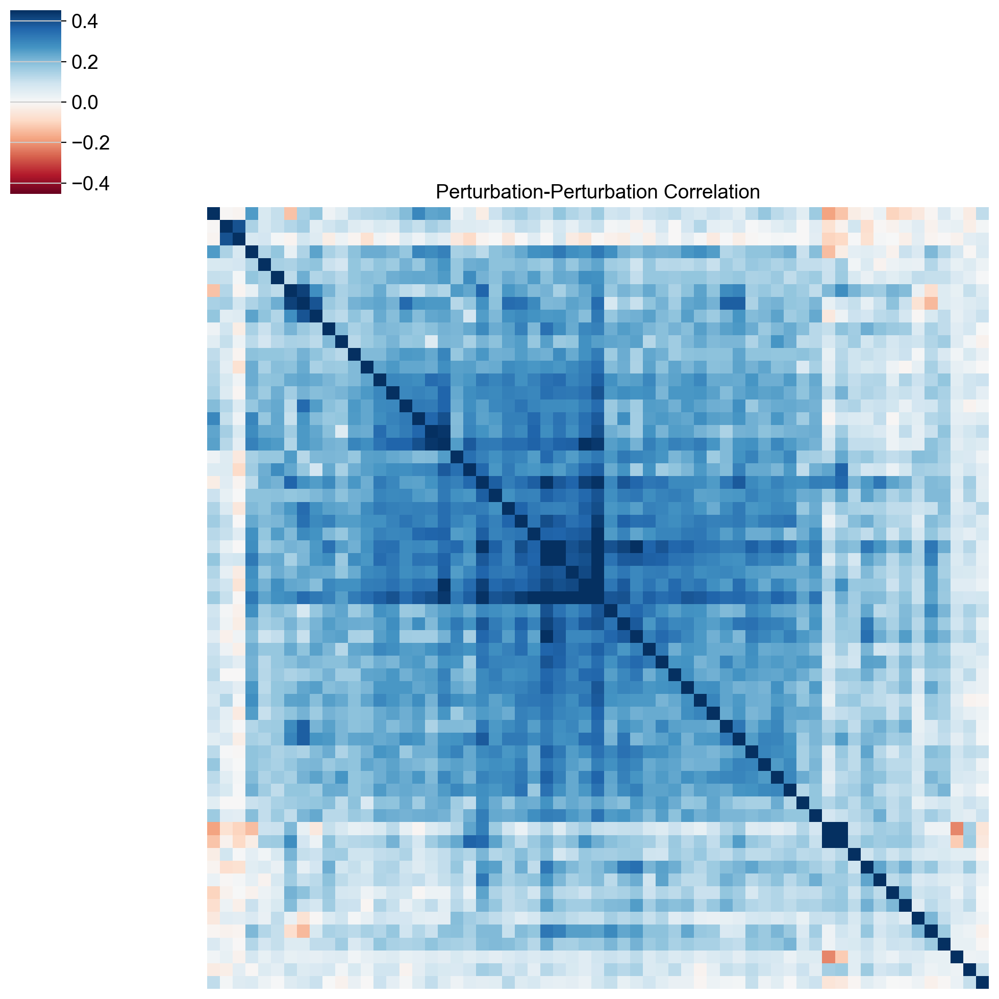

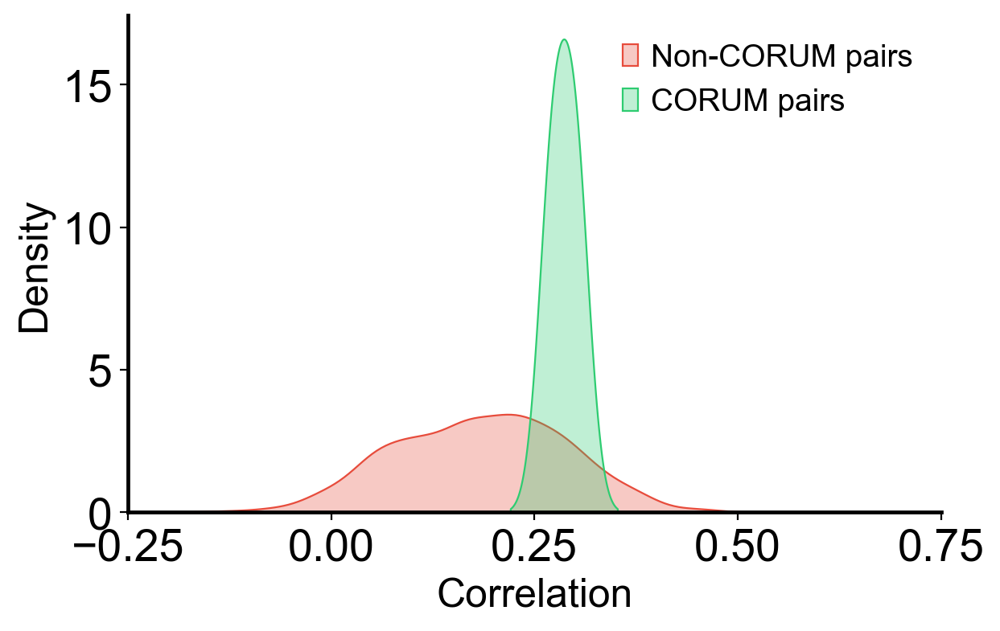

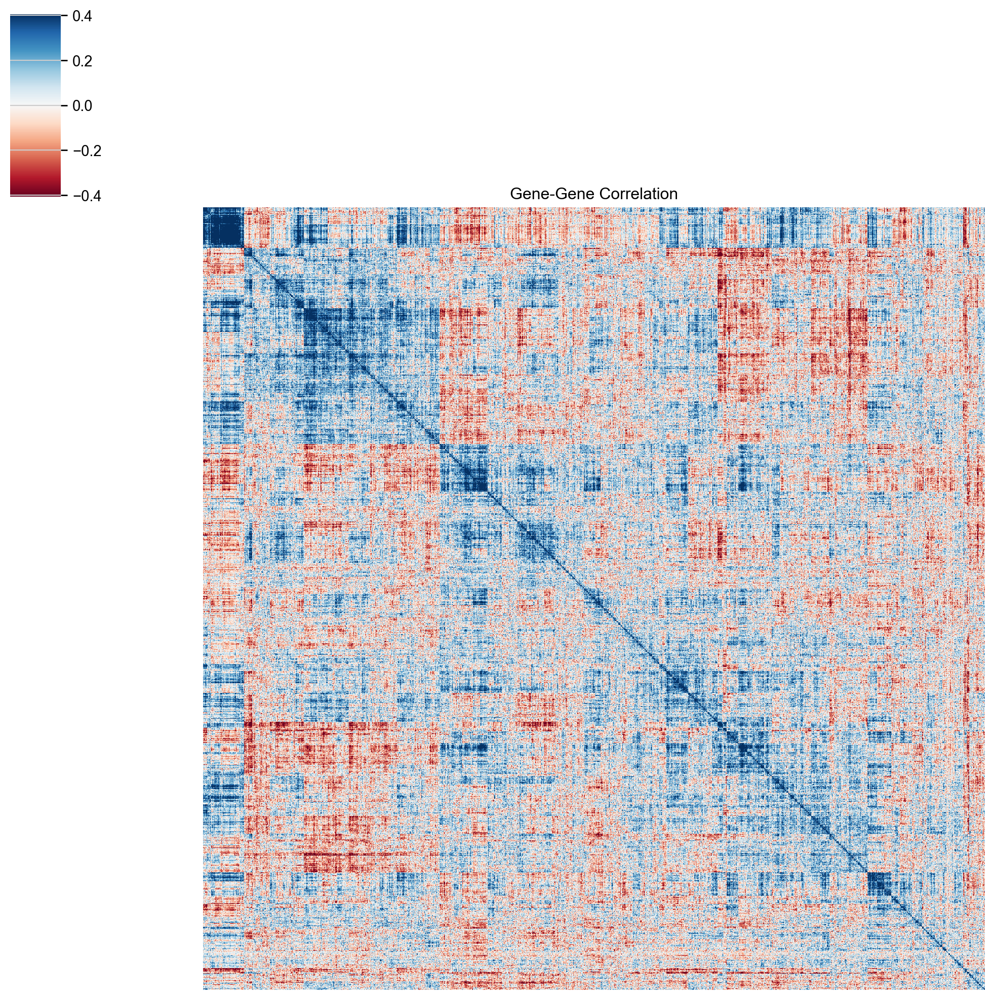

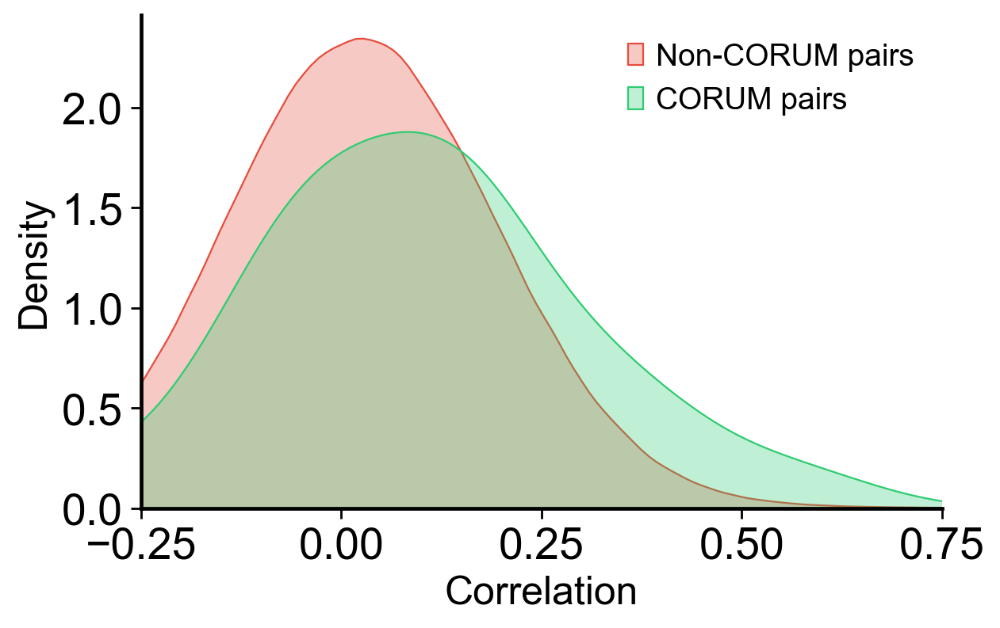

In [5]:
import json
with open('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/analysis_scripts/investigations/CORUM5.1_physical_interactors.json', 'r') as f:
    corum_complexes = json.load(f)
fig, perturb_corrs, mp = psp.da.create_corrmatrix(adata_subset,title='Perturbation-Perturbation Correlation', mode='perturb')
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Perturbation_Correlation.png', dpi=1200)
corum, non_corum = psp.da.get_corum_perturbation_pairs_from_list(perturb_corrs.columns.unique(), corum_complexes)
fig, u_stat, p_value = psp.da.benchmark_corum_vs_noncorum_pairs(perturb_corrs, corum, non_corum)
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Perturbation_Correlation_Corum_vs_NonCorum_Benchmark.svg')

fig, gene_corrs, mp = psp.da.create_corrmatrix(adata_subset,title='Gene-Gene Correlation', mode='gene')
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Gene_Gene_Correlation.png', dpi=1200)
corum_genes, non_corum_genes = psp.da.get_corum_perturbation_pairs_from_list(gene_corrs.index.unique(), corum_complexes)
fig, u_stat, p_value = psp.da.benchmark_corum_vs_noncorum_pairs(gene_corrs, corum_genes, non_corum_genes)
fig.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Gene_Gene_Correlation_Corum_vs_NonCorum_Benchmark.svg')
perturb_corrs.to_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Perturbation_Correlation.csv')
gene_corrs.to_csv('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Gene_Gene_Correlation.csv')

Applying HDBSCAN to cluster

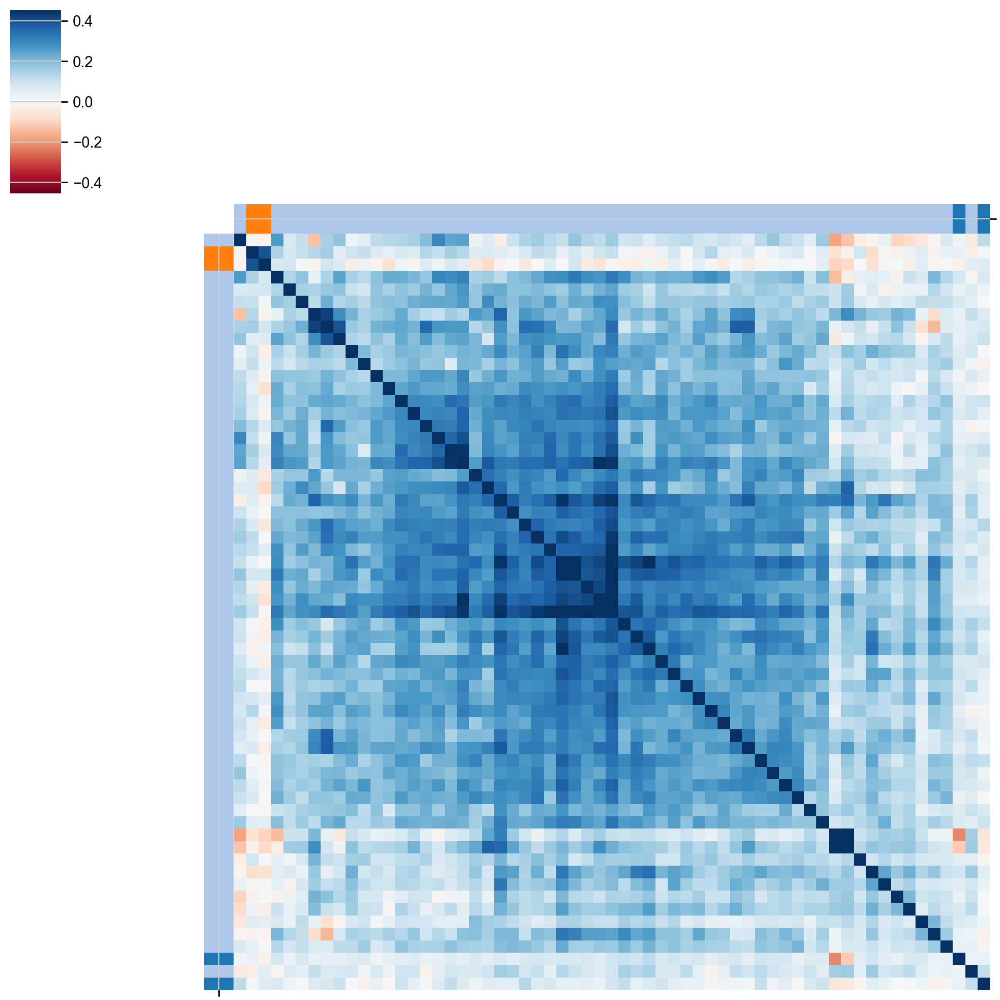

HDBSCAN Found 2 Clusters
Correlation matrix on only genes assigned a HDBScan Cluster: 59 total genes


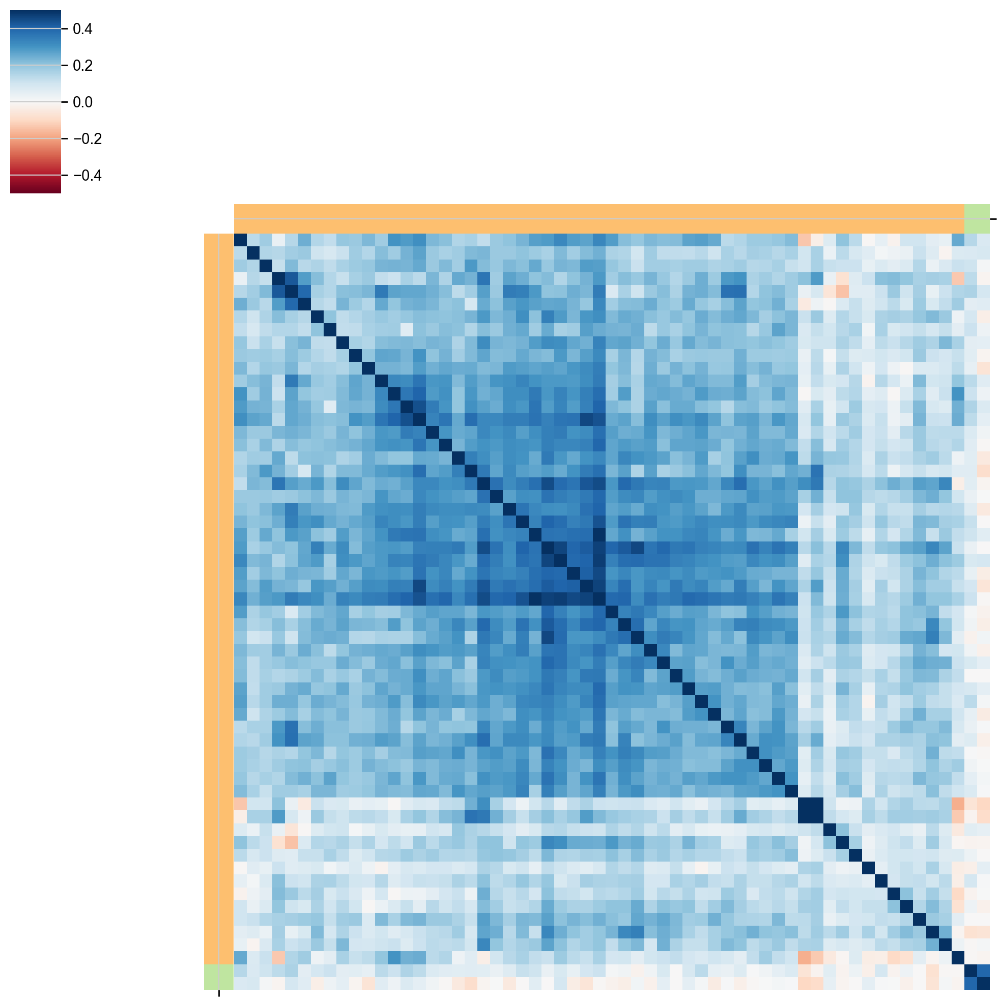

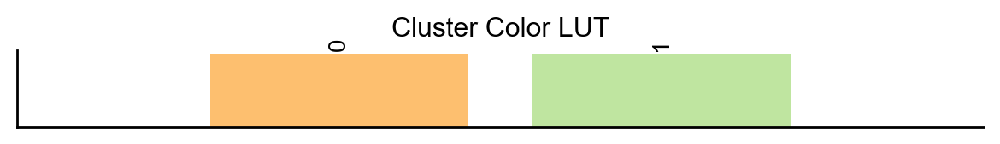

In [6]:
from sklearn.cluster import HDBSCAN
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd

clusterer = HDBSCAN(metric='precomputed', min_cluster_size=2, cluster_selection_method='eom', min_samples=1)
fig1, fig2, perturbation_HDBSCAN_labels = psp.da.compute_HDBSCAN_clusters(perturb_corrs, clusterer)
fig1.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Perturbation_Correlation_HDBSCAN_Clusters_Computed.png', dpi=1200)
fig2.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Perturbation_Perturbation_Correlation_HDBSCAN_Clusters_Only_Clustermap.png', dpi=1200)

Jul 12 10:39:41 AM: Fitting a centered embedding into R^20, for a graph with 1747 items and 57514 edges.
Jul 12 10:39:41 AM: `embed` method parameters: eps=1.0e-09, max_iter=1000, memory_size=10
Jul 12 10:39:43 AM: iteration 0000 | distortion 0.356630 | residual norm 0.0018466 | step length 6680.17 | percent change 6.5993
Jul 12 10:41:06 AM: iteration 0100 | distortion 0.215286 | residual norm 0.000119675 | step length 1 | percent change 1.04801
Jul 12 10:42:49 AM: iteration 0200 | distortion 0.215074 | residual norm 3.68914e-05 | step length 1 | percent change 0.085037
Jul 12 10:44:40 AM: iteration 0300 | distortion 0.215035 | residual norm 9.22875e-06 | step length 1 | percent change 0.0486768
Jul 12 10:47:11 AM: iteration 0400 | distortion 0.215033 | residual norm 2.8768e-06 | step length 1.01 | percent change 3.02114e-06
Jul 12 10:49:39 AM: iteration 0500 | distortion 0.215033 | residual norm 2.62788e-06 | step length 1.01 | percent change 2.75974e-06
Jul 12 10:52:57 AM: iteration 

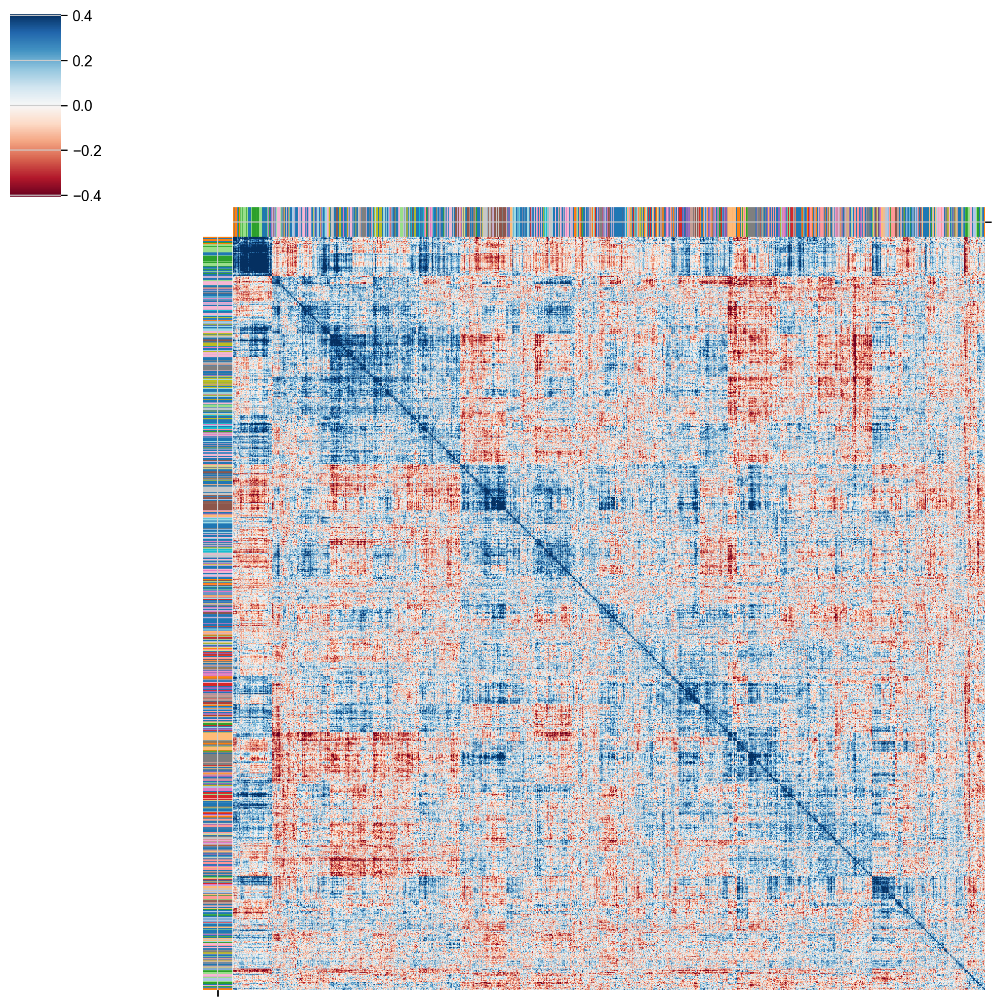

HDBSCAN Found 56 Clusters
Correlation matrix on only genes assigned a HDBScan Cluster: 1232 total genes


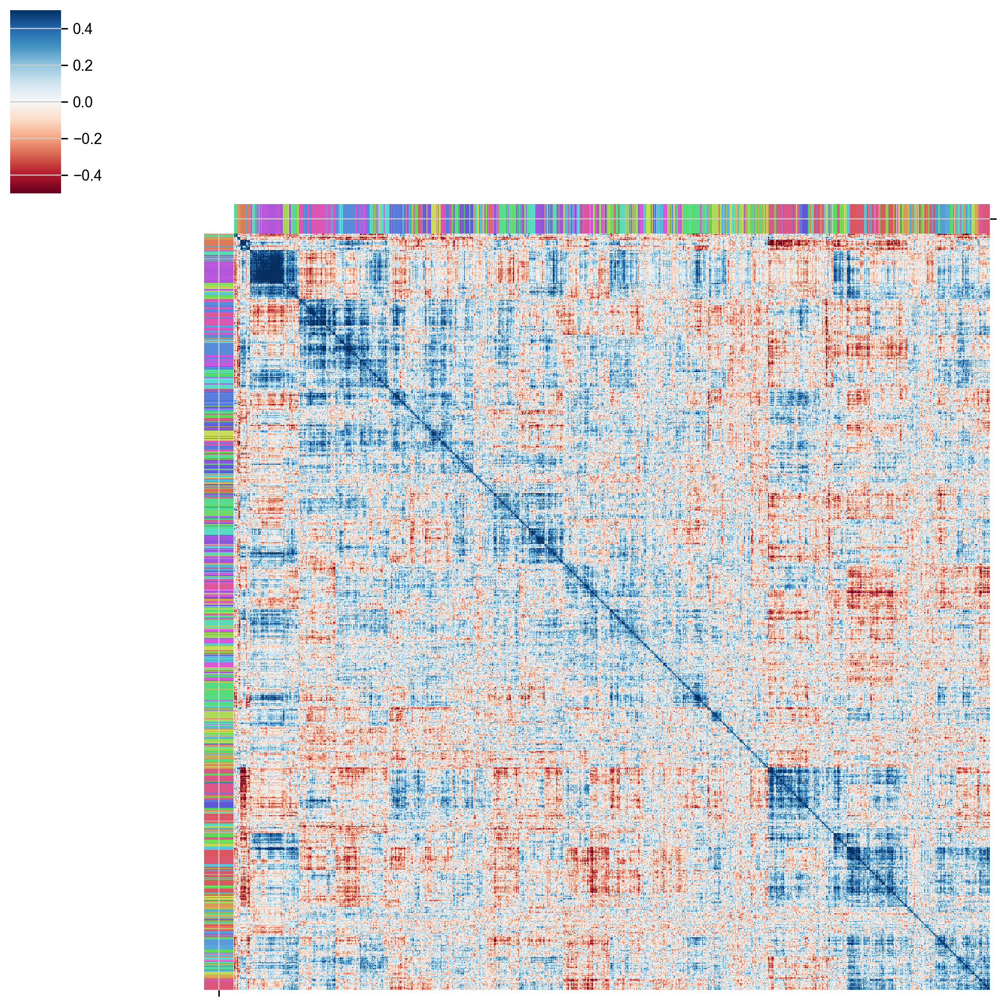

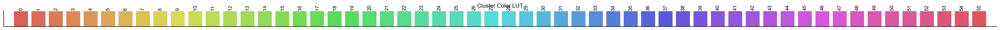

In [7]:
# here letting min_cluster_size = 5 to allow for more clusters
from sklearn.cluster import HDBSCAN
clusterer = HDBSCAN(metric='euclidean', min_cluster_size=10, cluster_selection_method='leaf', min_samples=1)
fig1, fig2, gene_HDBSCAN_labels = psp.da.compute_HDBSCAN_clusters_20d_embedding(bulks_subset, gene_corrs, clusterer)
fig1.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Gene_Gene_Correlation_HDBSCAN_Clusters_Computed.png', dpi=1200)
fig2.savefig('/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers_Gene_Gene_Correlation_HDBSCAN_Clusters_Only_Clustermap.png', dpi=1200)

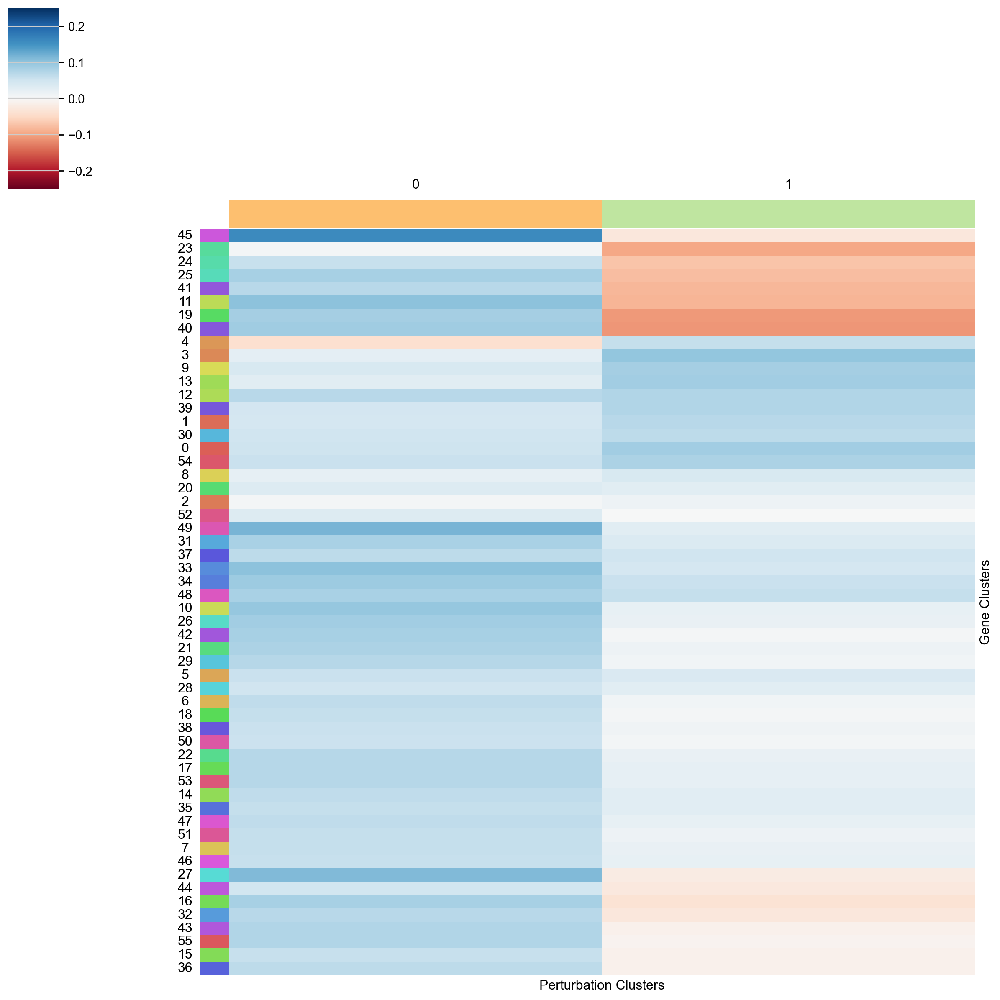

In [8]:
psp.da.plot_pert_gene_summary_heatmap(gene_HDBSCAN_labels, perturbation_HDBSCAN_labels, mp, vmin = -0.25, vmax = 0.25)

In [22]:
mp_standardized = psp.da.standardize(mp, axis=0)

from sklearn.manifold import SpectralEmbedding
import pymde
def embed_spectral_mde(mp_standardized, n_components = 20,n_neighbors = 7, random_state = 42, repulsive_fraction = 5):
    embedder = SpectralEmbedding(
        n_components=n_components,
        affinity='nearest_neighbors',
        eigen_solver='arpack',
        random_state=random_state,
        n_neighbors = 10
    )
    X = embedder.fit_transform(mp_standardized)
    pymde.seed(random_state)
    mde = pymde.preserve_neighbors(X, embedding_dim=2, n_neighbors=n_neighbors,repulsive_fraction=repulsive_fraction)
    Y = mde.embed(verbose=True, eps=1e-9, max_iter=2000)
    return Y

mde_embedding = embed_spectral_mde(mp_standardized, n_neighbors = 7, repulsive_fraction = 5)

Jul 12 11:10:01 AM: Fitting a centered embedding into R^2, for a graph with 61 items and 1547 edges.
Jul 12 11:10:01 AM: `embed` method parameters: eps=1.0e-09, max_iter=2000, memory_size=10
Jul 12 11:10:01 AM: iteration 0000 | distortion 0.384952 | residual norm 0.0328292 | step length 5.505 | percent change 1.6362
Jul 12 11:10:02 AM: iteration 0200 | distortion 0.326315 | residual norm 0.000546055 | step length 1 | percent change 1.5298
Jul 12 11:10:02 AM: iteration 0400 | distortion 0.325512 | residual norm 2.04692e-05 | step length 0 | percent change 0
Jul 12 11:10:04 AM: iteration 0600 | distortion 0.325512 | residual norm 2.04692e-05 | step length 0 | percent change 0
Jul 12 11:10:05 AM: iteration 0800 | distortion 0.325512 | residual norm 2.04692e-05 | step length 0 | percent change 0
Jul 12 11:10:06 AM: iteration 1000 | distortion 0.325512 | residual norm 2.04692e-05 | step length 0 | percent change 0
Jul 12 11:10:08 AM: iteration 1200 | distortion 0.325512 | residual norm 2.04

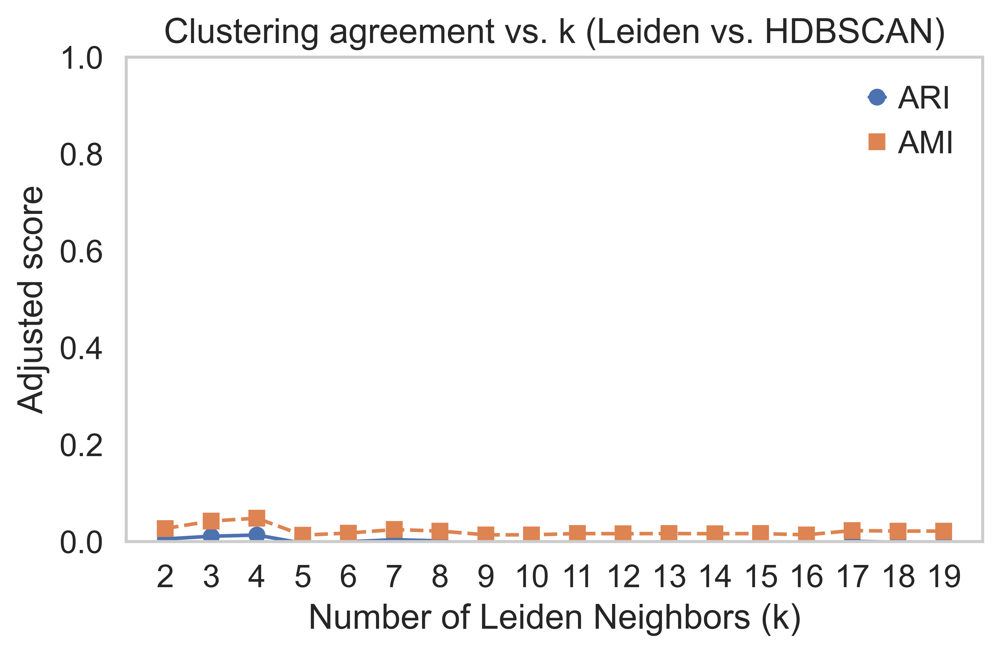

In [23]:
psp.da.plot_cluster_agreement(mde_embedding, perturbation_HDBSCAN_labels)

6 CORUM complexes present


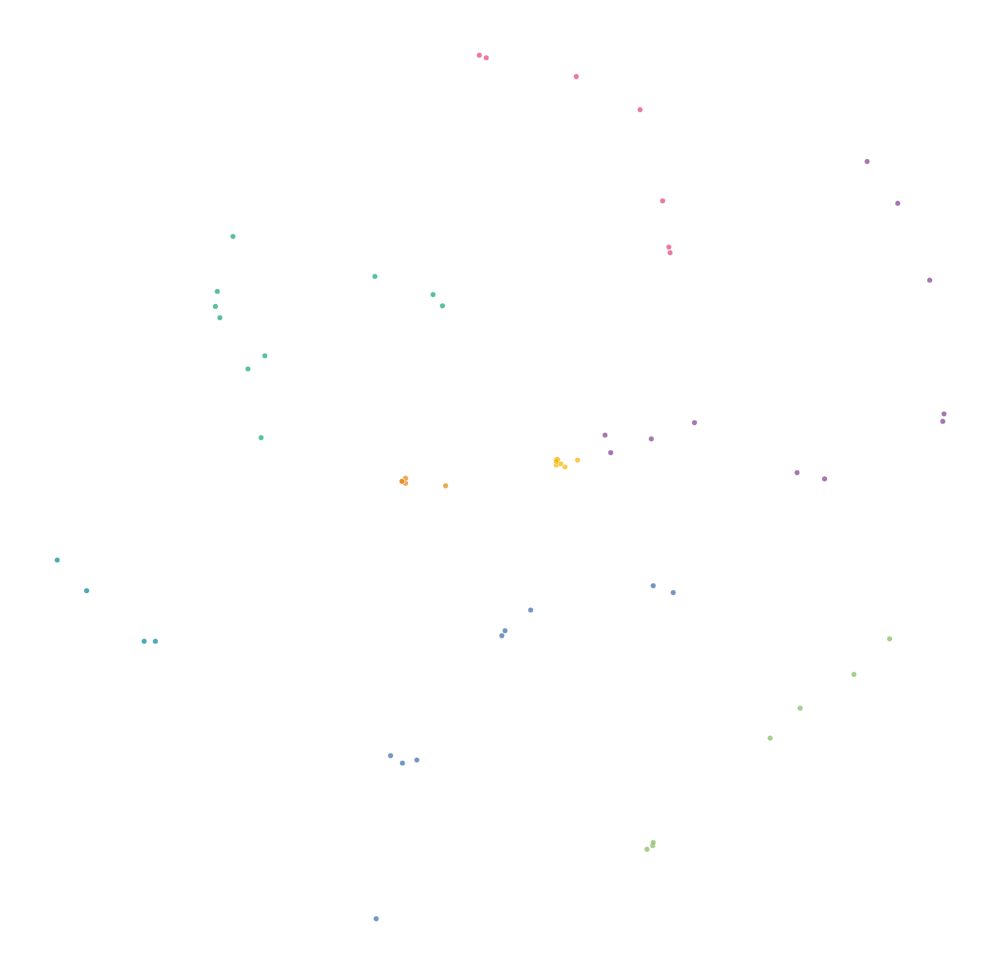

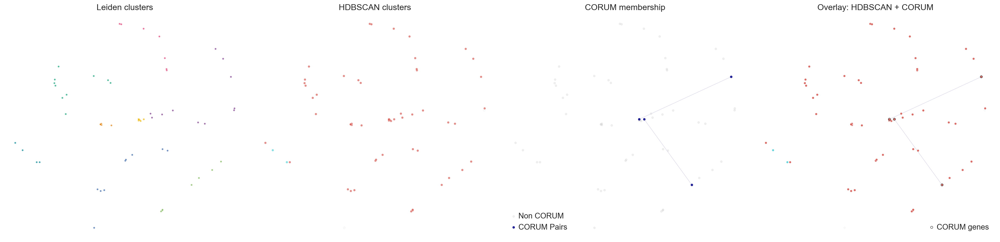

In [24]:
embedding_df = psp.da.plot_mde(mde_embedding, perturbation_HDBSCAN_labels, bulks_subset, n_neighbors = 4, corum_complexes = corum_complexes, save_dir_stem = '/tscc/projects/ps-malilab/ydoctor/KOLF_Perturbation_Atlas/KOLF_Perturbation_Atlas_Analysis/output_files/KOLF_Chromatin_Modifiers', marker_size = 10, marker_opacity = 0.7)

In [85]:
# Print, per leiden cluster, a comma-separated list of gene targets
for cluster, group in embedding_df.groupby('leiden cluster'):
    gene_targets = group['gene_target'].tolist()
    print(f"Leiden cluster {cluster}: {', '.join(gene_targets)}")

Leiden cluster 0: JAK2, KAT2B, KAT6A, KMT2E, NTC, PPP1CB, PRKAB1, PRKAB2, SIRT2, TP53BP1, YWHAH
Leiden cluster 1: ATR, BAP1, BARD1, HDAC3, HDAC6, MSK1, PDP1, PIM1, PRKAA1, YWHAE
Leiden cluster 2: BRPF1, CBX2, HDAC4, HDAC8, KAT2A, NEDD4, PPP1CA, PPP4C, TAF1
Leiden cluster 3: BAZ1B, CBL, CBX3, HDAC1, HDAC7, KAT6B, PRKAG1, TET1
Leiden cluster 4: BPTF, BRD7, HASPIN, KDM3B, KDM5C, PRKCB, TRIM24
Leiden cluster 5: DNMT1, EYA3, HDAC2, KDM5B, KMT2D, PPP1CC, UHRF1
Leiden cluster 6: CHD1, HDAC11, PRKCA, PRKCD, YWHAG
Leiden cluster 7: CSNK2A1, KAT3A, KMT2C, PHF6


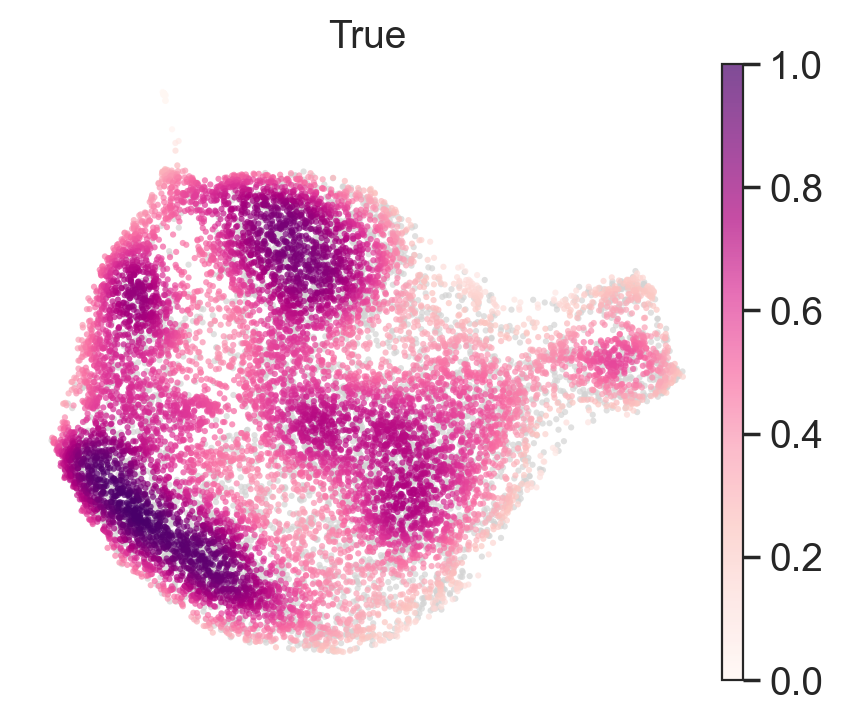

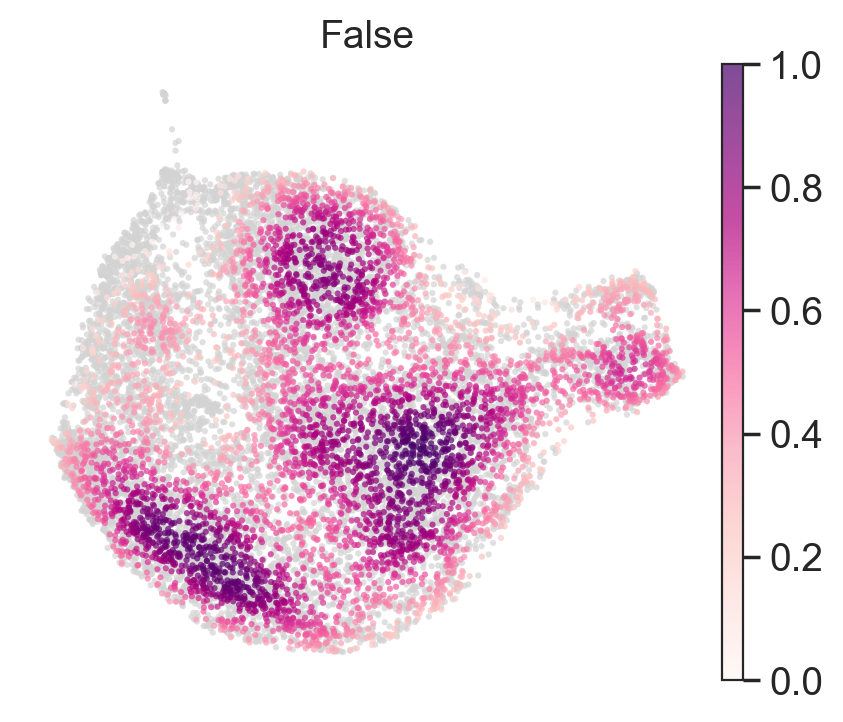

In [ ]:
sc.pp.pca(adata_subset, n_comps=50)
sc.pp.neighbors(adata_subset, use_rep = 'X_pca')
sc.tl.umap(adata_subset, min_dist = 0.1, spread = 1.5)
sc.tl.leiden(adata_subset, n_iterations = 2, resolution = 1.5)
sc.pl.umap(adata_subset, color = 'leiden', frameon = False)
sc.tl.embedding_density(adata_subset, groupby='perturbed')
sc.pl.embedding_density(adata_subset, groupby='perturbed', group="True", frameon = False, fg_dotsize=20, color_map='RdPu', bg_dotsize=20, alpha=0.7)
sc.pl.embedding_density(adata_subset, groupby='perturbed', group="False", frameon = False, fg_dotsize=20, color_map='RdPu', bg_dotsize=20, alpha=0.7)

computing density on 'umap'
--> added
    'umap_density_gene_target', densities (adata.obs)
    'umap_density_gene_target_params', parameter (adata.uns)


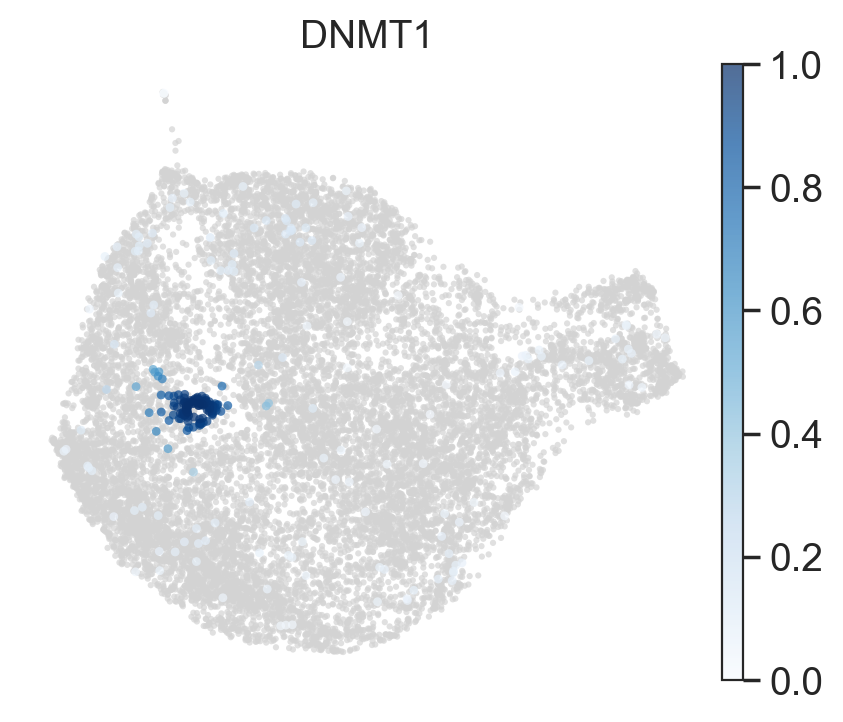

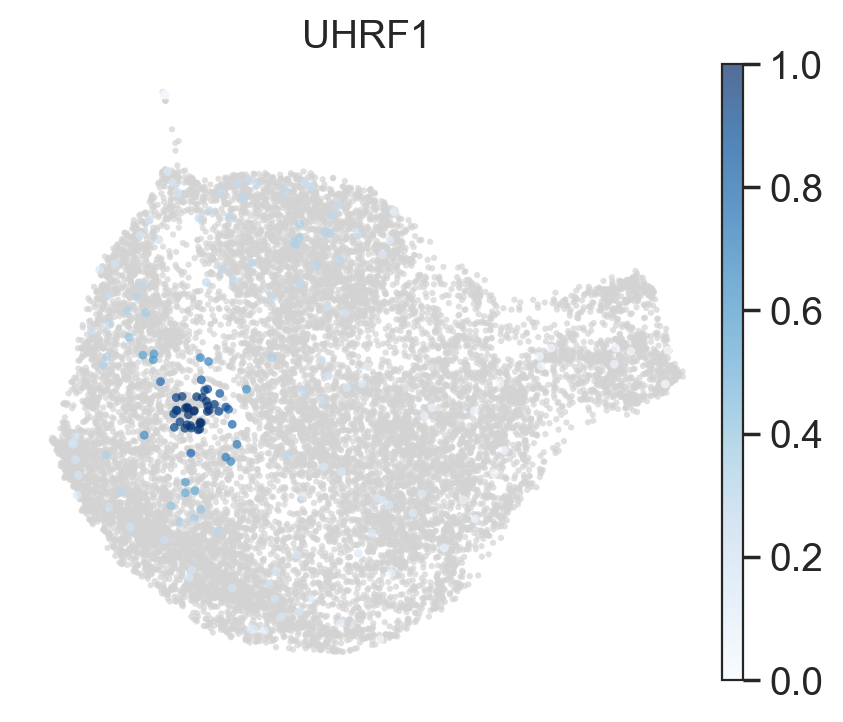

In [47]:
sc.tl.embedding_density(adata_subset, groupby='gene_target')
sc.pl.embedding_density(adata_subset, groupby='gene_target', group="DNMT1", frameon = False, fg_dotsize=40, color_map='Blues', bg_dotsize=20, alpha=0.7)
sc.pl.embedding_density(adata_subset, groupby='gene_target', group="UHRF1", frameon = False, fg_dotsize=40, color_map='Blues', bg_dotsize=20, alpha=0.7)